# Исследование для развлекательного приложения Procrastinate Pro+

Несмотря на огромные вложения в рекламу, последние несколько месяцев Procrastinate Pro+ терпит убытки. Наша задача — разобраться в причинах и помочь компании выйти в плюс.


Есть данные о пользователях, привлечённых с 1 мая по 27 октября 2019 года:
* лог сервера с данными об их посещениях,
* выгрузка их покупок за этот период,
* рекламные расходы.


Предстоит изучить:
* откуда приходят пользователи и какими устройствами они пользуются,
* сколько стоит привлечение пользователей из различных рекламных каналов;
* сколько денег приносит каждый клиент,
* когда расходы на привлечение клиента окупаются,
* какие факторы мешают привлечению клиентов.

**Описание данных**

В нашем распоряжении три датасета. Файл *visits_info_short.csv* хранит лог сервера с информацией о посещениях сайта, *orders_info_short.csv* — информацию о заказах, а *costs_info_short.csv* — информацию о расходах на рекламу.

Структура visits_info_short.csv:
* User Id — уникальный идентификатор пользователя,
* Region — страна пользователя,
* Device — тип устройства пользователя,
* Channel — идентификатор источника перехода,
* Session Start — дата и время начала сессии,
* Session End — дата и время окончания сессии.


Структура orders_info_short.csv:
* User Id — уникальный идентификатор пользователя,
* Event Dt — дата и время покупки,
* Revenue — сумма заказа.


Структура costs_info_short.csv:
* dt — дата проведения рекламной кампании,
* Channel — идентификатор рекламного источника,
* costs — расходы на эту кампанию.

**Определим этапы работы:** 

1. Знакомство с данными, предобработка данных
2. Создание функций для дальнейшего анализа
3. Исследовательский анализ данных:
    - составим профили пользователей. Определим минимальную и максимальную даты привлечения пользователей.
    - выясним, из каких стран пользователи приходят в приложение и на какую страну приходится больше всего платящих пользователей. Построим таблицу, отражающую количество пользователей и долю платящих из каждой страны
    - узнаем, какими устройствами пользуются клиенты и какие устройства предпочитают платящие пользователи. Построим таблицу, отражающую количество пользователей и долю платящих для каждого устройства.
    - изучим рекламные источники привлечения и определите каналы, из которых пришло больше всего платящих пользователей. Построим таблицу, отражающую количество пользователей и долю платящих для каждого канала привлечения.       
4. Исследование общих маркетинговых показателей:
    - посчитаем общую сумму расходов на маркетинг
    - выясним, как траты распределены по рекламным источникам, то есть сколько денег потратили на каждый источник
    - построим визуализацию динамики изменения расходов во времени (по неделям и месяцам) по каждому источнику
    - узнаем, сколько в среднем стоило привлечение одного пользователя (CAC) из каждого источника, используя профили пользователей
5. Оценка окупаемости рекламы
    - проанализируем окупаемость рекламы c помощью графиков LTV и ROI, а также графиков динамики LTV, CAC и ROI
    - проверим конверсию пользователей и динамику её изменения. То же самое сделаем с удержанием пользователей. Построим и изучим графики конверсии и удержания
    - проанализируем окупаемость рекламы с разбивкой по устройствам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI
    - проанализируем окупаемость рекламы с разбивкой по странам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI
    - проанализируем окупаемость рекламы с разбивкой по рекламным каналам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI.
    - ответим на такие вопросы:
            - Окупается ли реклама, направленная на привлечение пользователей в целом?
            - Какие устройства, страны и рекламные каналы могут оказывать негативное влияние на окупаемость рекламы?
            - Чем могут быть вызваны проблемы окупаемости?
6. Выводы
    - выделим причины неэффективности привлечения пользователей
    - сформулируем рекомендации для отдела маркетинга.

## Знакомство с данными. Предобработка 

In [1]:
# импорт необходимых библиотек:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('seaborn-poster')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
# открываем файлы, сохраняем таблицы в переменных visits, orders и costs
try:    
    visits = pd.read_csv(r'\Users\Hp\Desktop\Практикум\Procrastinate\visits_info_short.csv') 
    orders = pd.read_csv(r'\Users\Hp\Desktop\Практикум\Procrastinate\orders_info_short.csv')
    costs = pd.read_csv(r'\Users\Hp\Desktop\Практикум\Procrastinate\costs_info_short.csv') 
except: 
    visits = pd.read_csv('https://code.s3.yandex.net/datasets/visits_info_short.csv')
    orders = pd.read_csv('https://code.s3.yandex.net/datasets/orders_info_short.csv')
    costs = pd.read_csv('https://code.s3.yandex.net/datasets/costs_info_short.csv')

### visits - логи сервера с информацией о посещениях сайта

In [3]:
display(visits.head())
visits.info()

,User Id,Region,Device,Channel,Session Start,Session End
0,981449118918,United States,iPhone,organic,2019-05-01 02:36:01,2019-05-01 02:45:01
1,278965908054,United States,iPhone,organic,2019-05-01 04:46:31,2019-05-01 04:47:35
2,590706206550,United States,Mac,organic,2019-05-01 14:09:25,2019-05-01 15:32:08
3,326433527971,United States,Android,TipTop,2019-05-01 00:29:59,2019-05-01 00:54:25
4,349773784594,United States,Mac,organic,2019-05-01 03:33:35,2019-05-01 03:57:40


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309901 entries, 0 to 309900
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   User Id        309901 non-null  int64 
 1   Region         309901 non-null  object
 2   Device         309901 non-null  object
 3   Channel        309901 non-null  object
 4   Session Start  309901 non-null  object
 5   Session End    309901 non-null  object
dtypes: int64(1), object(5)
memory usage: 14.2+ MB


**Таблица содержит 309901 наблюдение, пропусков в столбцах нет.**

1. Предобработка таблицы:
 * проверим наличие полных дубликатов
 * приведем названия столбцов к единому стилю
 * столбцы Session Start и Session End хранят значения с типом 'object', приведем к корректному типу 'datetime'
 
 
2. Познакомимся с данными:
 * проверим уникальные значения в столбцах Region, Device и Channel: нет ли среди них неявных дубликатов
 * посмотрим на распределение данных в этих столбцах


In [4]:
print('Число дубликатов в таблице visits:', visits.duplicated().sum())

Число дубликатов в таблице visits: 0


In [5]:
# приводим названия всех столбцов к "змеиному регистру":
visits.columns = [x.lower() for x in visits.columns]
visits.columns = [x.replace(' ', '_') for x in visits.columns.values]
print('Названия столбцов в таблице visits:', visits.columns.values)

Названия столбцов в таблице visits: ['user_id' 'region' 'device' 'channel' 'session_start' 'session_end']


In [6]:
# меняем тип данных в стобцах с началом и завершением сессии:
visits['session_start'] = pd.to_datetime(visits['session_start'])
visits['session_end'] = pd.to_datetime(visits['session_end'])

**Столбцы region, device и chennel:**

United States    207327
UK                36419
France            35396
Germany           30759
Name: region, dtype: int64

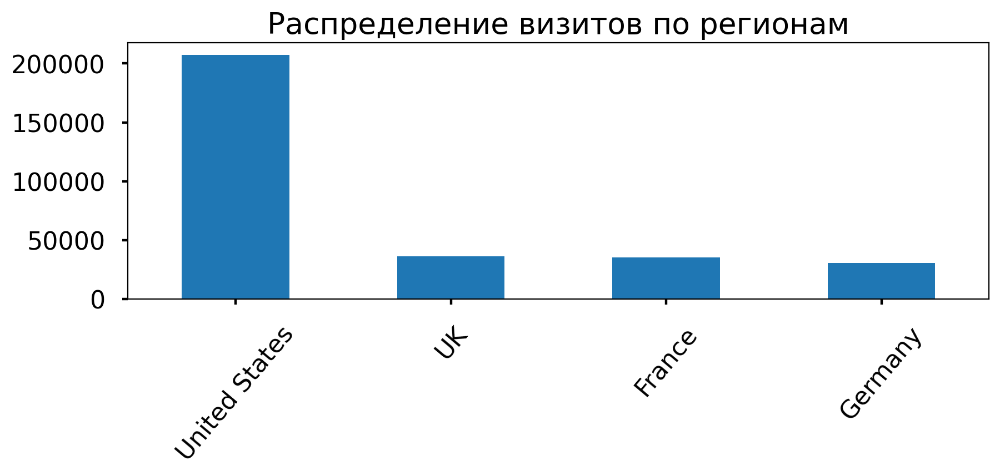

In [7]:
display(visits['region'].value_counts())
visits['region'].value_counts().plot(kind='bar', rot=50, figsize=(10,3), title='Распределение визитов по регионам');


Столбец *region* содержит 4 региона: United States, UK, France, Germany. Абсолютное большинство значений относится к United States, в целом распределение выглядит нормальным

iPhone     112603
Android     72590
PC          62686
Mac         62022
Name: device, dtype: int64

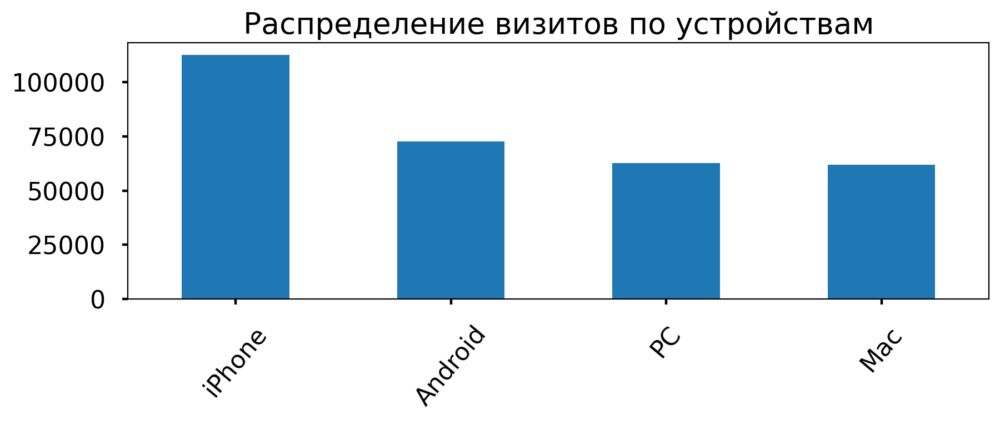

In [8]:
display(visits['device'].value_counts())
visits['device'].value_counts().plot(kind='bar', rot=50, figsize=(10,3), title='Распределение визитов по устройствам');

В столбце *device* встречаются 4 вида устройств: iPhone, Android, Pc и Mac, большинство клиентов пользуются iPhone, распределение выглядит нормально 

organic               107760
TipTop                 54794
FaceBoom               49022
WahooNetBanner         20465
LeapBob                17013
OppleCreativeMedia     16794
RocketSuperAds         12724
YRabbit                 9053
MediaTornado            8878
AdNonSense              6891
lambdaMediaAds          6507
Name: channel, dtype: int64

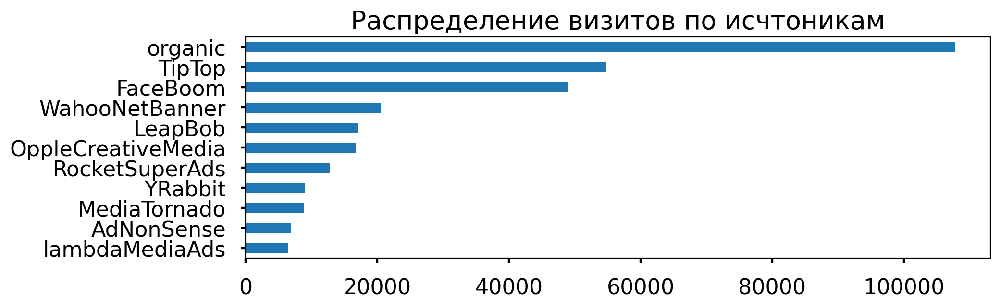

In [9]:
display(visits['channel'].value_counts())
visits['channel'].value_counts().sort_values().plot(kind='barh',  figsize=(10,3), title='Распределение визитов по исчтоникам');

В столбце *channel* встречаются 11 видов каналов, абсолютное большинство привлеченных пользователей - органические. Неявных дубликатов в названиях каналов нет, распределение выглядит нормальным

In [10]:
# доп. вызов info для проверки изменений:
visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309901 entries, 0 to 309900
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   user_id        309901 non-null  int64         
 1   region         309901 non-null  object        
 2   device         309901 non-null  object        
 3   channel        309901 non-null  object        
 4   session_start  309901 non-null  datetime64[ns]
 5   session_end    309901 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(3)
memory usage: 14.2+ MB


**Таблица visits готова к анализу**

### orders - информация о заказах

In [11]:
display(orders.head())
display(orders.info())
orders.describe()

,User Id,Event Dt,Revenue
0,188246423999,2019-05-01 23:09:52,4.99
1,174361394180,2019-05-01 12:24:04,4.99
2,529610067795,2019-05-01 11:34:04,4.99
3,319939546352,2019-05-01 15:34:40,4.99
4,366000285810,2019-05-01 13:59:51,4.99


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40212 entries, 0 to 40211
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   User Id   40212 non-null  int64  
 1   Event Dt  40212 non-null  object 
 2   Revenue   40212 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 942.6+ KB


None

,User Id,Revenue
count,4.021200e+04,40212.000000
mean,4.990295e+11,5.370608
std,2.860937e+11,3.454208
min,5.993260e+05,4.990000
25%,2.511324e+11,4.990000
50%,4.982840e+11,4.990000
75%,7.433327e+11,4.990000
max,9.998954e+11,49.990000


**Таблица содержит 40212 наблюдений, пропусков в столбцах нет.** Столбец Revenue содержит выбросы максимальное значение 49.99, похоже на выброс.

1. Предобработка таблицы:

* проверим наличие полных дубликатов
* приведем названия столбцов к единому стилю
* приведем столбец Event Dt типу datetime

2. Посмотрим какие значения хранит столбец Revenue


In [12]:
print('Число дубликатов в таблице orders:', orders.duplicated().sum())

Число дубликатов в таблице orders: 0


In [13]:
# приводим названия всех столбцов к "змеиному регистру":
orders.columns = [x.lower() for x in orders.columns]
orders.columns = [x.replace(' ', '_') for x in orders.columns.values]
print('Названия столбцов в таблице visits:', orders.columns.values)

Названия столбцов в таблице visits: ['user_id' 'event_dt' 'revenue']


In [14]:
# приводим столбец с датой к корректному типу:
orders['event_dt'] = pd.to_datetime(orders['event_dt'])

In [15]:
orders['revenue'].value_counts()

4.99     38631
5.99       780
9.99       385
49.99      212
19.99      204
Name: revenue, dtype: int64

Чаще всего клиент платит 4.99 - заказов на такую сумму более 38 тысяч. Есть заказы на 5.99, 9.99, 19.99 и 49.99 - более дорогих заказов куда меньше, вероятно, такие суммы характерны для оплаты, например, годовой подписки или подписки с какой-либо доп.опцией, неудивительно, что таких сумм в наборе данных намного меньше, в целом, распределение выглядит нормально.

In [16]:
# доп.вызов info для проверки изменений:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40212 entries, 0 to 40211
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   user_id   40212 non-null  int64         
 1   event_dt  40212 non-null  datetime64[ns]
 2   revenue   40212 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 942.6 KB


**Таблица orders готова к анализу**

### costs - информация о расходах на рекламу

In [17]:
display(costs.head())
display(costs.info())
costs.describe()

,dt,Channel,costs
0,2019-05-01,FaceBoom,113.3
1,2019-05-02,FaceBoom,78.1
2,2019-05-03,FaceBoom,85.8
3,2019-05-04,FaceBoom,136.4
4,2019-05-05,FaceBoom,122.1


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   dt       1800 non-null   object 
 1   Channel  1800 non-null   object 
 2   costs    1800 non-null   float64
dtypes: float64(1), object(2)
memory usage: 42.3+ KB


None

,costs
count,1800.000000
mean,58.609611
std,107.740223
min,0.800000
25%,6.495000
50%,12.285000
75%,33.600000
max,630.000000


**Таблица содержит 1800  наблюдений, пропусков в столбцах нет.** Наблюдаем большой разброс данных, минимальное значение: 0.8, а максимальное 630.

1. Предобработка таблицы:

* проверим наличие полных дубликатов
* приведем названия столбцов к единому стилю
* приведем столбец  Dt к корректному типу

2. Знакомство с данными:
* посмотрим на уникальные значения в столбце Channel, проверим на наличие неявных дубликатов

In [18]:
print('Число дубликатов в таблице costs:', costs.duplicated().sum())

Число дубликатов в таблице costs: 0


In [19]:
costs.columns = [x.lower() for x in costs.columns]
print('Названия столбцов в таблице costs:', costs.columns.values)

Названия столбцов в таблице costs: ['dt' 'channel' 'costs']


In [20]:
# приводим столбец с датой к формату "дата без времени":
costs['dt'] = pd.to_datetime(costs['dt']).dt.date

In [21]:
costs['channel'].value_counts()

FaceBoom              180
MediaTornado          180
RocketSuperAds        180
TipTop                180
YRabbit               180
AdNonSense            180
LeapBob               180
OppleCreativeMedia    180
WahooNetBanner        180
lambdaMediaAds        180
Name: channel, dtype: int64

Наблюдаем в столбце *channel* 10 каналов (в таблице *visits* таких каналов 11, здесь ожидаемо не видим бесплатный *organic*). Неявных дубликатов нет, на каждый канал приходится по 180 строк.

In [22]:
# доп. вызов info для проверки изменений:
costs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   dt       1800 non-null   object 
 1   channel  1800 non-null   object 
 2   costs    1800 non-null   float64
dtypes: float64(1), object(2)
memory usage: 42.3+ KB


**Таблица costs готова к анализу**

### Вывод

Ознакомились с данными всех трех таблиц. В таблицах нет пропусков и дубликатов. 

Все данные предобратаны:

* столбцы приведены к единому стилю
* изменены типы данных в столбцах, хранящих даты
* проверено распределение данных, аномалий не обнаружено

**Данные из всех таблиц готовы к дальнейшему анализу**

## Функции для расчёта и анализа LTV, ROI, удержания и конверсии.

Задаем функции для вычисления значений метрик:

- get_profiles() — для создания профилей пользователей,
- get_retention() — для подсчёта Retention Rate,
- get_conversion() — для подсчёта конверсии,
- get_ltv() — для подсчёта LTV.

А также функции для построения графиков:

- filter_data() — для сглаживания данных,
- plot_retention() — для построения графика Retention Rate,
- plot_conversion() — для построения графика конверсии,
- plot_ltv_roi — для визуализации LTV и ROI.

### Создание профилей пользователей: get_profiles()

In [23]:
def get_profiles(sessions, orders, ad_costs):

    # находим параметры первых посещений
    profiles = (
        sessions.sort_values(by=['user_id', 'session_start'])
        .groupby('user_id')
        .agg(
            {
                'session_start': 'first',
                'channel': 'first',
                'device': 'first',
                'region': 'first',
            }
        )
        .rename(columns={'session_start': 'first_ts'})
        .reset_index()
    )
     
    # для когортного анализа определяем дату первого посещения
    # и первый день месяца, в который это посещение произошло
    profiles['dt'] = profiles['first_ts'].dt.date
    profiles['month'] = profiles['first_ts'].astype('datetime64[M]')
    
    
    # добавляем признак платящих пользователей
    profiles['payer'] = profiles['user_id'].isin(orders['user_id'].unique())



    # считаем количество уникальных пользователей
    # с одинаковыми источником и датой привлечения
    new_users = (
        profiles.groupby(['dt', 'channel'])
        .agg({'user_id': 'nunique'})
        .rename(columns={'user_id': 'unique_users'})
        .reset_index()
    )

    # объединяем траты на рекламу и число привлечённых пользователей
    ad_costs = ad_costs.merge(new_users, on=['dt', 'channel'], how='left')

    # делим рекламные расходы на число привлечённых пользователей
    ad_costs['acquisition_cost'] = ad_costs['costs'] / ad_costs['unique_users']

    # добавляем стоимость привлечения в профили
    profiles = profiles.merge(
        ad_costs[['dt', 'channel', 'acquisition_cost']],
        on=['dt', 'channel'],
        how='left',
    )

    # стоимость привлечения органических пользователей равна нулю
    profiles['acquisition_cost'] = profiles['acquisition_cost'].fillna(0)

    return profiles

### Рассчет Retention Rate: get_retention()

In [24]:
def get_retention(
    profiles,
    sessions,
    observation_date,
    horizon_days,
    dimensions=[],
    ignore_horizon=False,
):

    # добавляем столбец payer в передаваемый dimensions список
    dimensions = ['payer'] + dimensions

    # исключаем пользователей, не «доживших» до горизонта анализа
    last_suitable_acquisition_date = observation_date
    if not ignore_horizon:
        last_suitable_acquisition_date = observation_date - timedelta(
            days=horizon_days - 1
        )
    result_raw = profiles.query('dt <= @last_suitable_acquisition_date')

    # собираем «сырые» данные для расчёта удержания
    result_raw = result_raw.merge(
        sessions[['user_id', 'session_start']], on='user_id', how='left'
    )
    result_raw['lifetime'] = (
        result_raw['session_start'] - result_raw['first_ts']
    ).dt.days

    # функция для группировки таблицы по желаемым признакам
    def group_by_dimensions(df, dims, horizon_days):
        result = df.pivot_table(
            index=dims, columns='lifetime', values='user_id', aggfunc='nunique'
        )
        cohort_sizes = (
            df.groupby(dims)
            .agg({'user_id': 'nunique'})
            .rename(columns={'user_id': 'cohort_size'})
        )
        result = cohort_sizes.merge(result, on=dims, how='left').fillna(0)
        result = result.div(result['cohort_size'], axis=0)
        result = result[['cohort_size'] + list(range(horizon_days))]
        result['cohort_size'] = cohort_sizes
        return result

    # получаем таблицу удержания
    result_grouped = group_by_dimensions(result_raw, dimensions, horizon_days)

    # получаем таблицу динамики удержания
    result_in_time = group_by_dimensions(
        result_raw, dimensions + ['dt'], horizon_days
    )

    # возвращаем обе таблицы и сырые данные
    return result_raw, result_grouped, result_in_time 

###  Рассчет конверсии: get_conversion()

In [25]:
def get_conversion(
    profiles,
    purchases,
    observation_date,
    horizon_days,
    dimensions=[],
    ignore_horizon=False,
):

    # исключаем пользователей, не «доживших» до горизонта анализа
    last_suitable_acquisition_date = observation_date
    if not ignore_horizon:
        last_suitable_acquisition_date = observation_date - timedelta(
            days=horizon_days - 1
        )
    result_raw = profiles.query('dt <= @last_suitable_acquisition_date')

    # определяем дату и время первой покупки для каждого пользователя
    first_purchases = (
        purchases.sort_values(by=['user_id', 'event_dt'])
        .groupby('user_id')
        .agg({'event_dt': 'first'})
        .reset_index()
    )

    # добавляем данные о покупках в профили
    result_raw = result_raw.merge(
        first_purchases[['user_id', 'event_dt']], on='user_id', how='left'
    )

    # рассчитываем лайфтайм для каждой покупки
    result_raw['lifetime'] = (
        result_raw['event_dt'] - result_raw['first_ts']
    ).dt.days

    # группируем по cohort, если в dimensions ничего нет
    if len(dimensions) == 0:
        result_raw['cohort'] = 'All users' 
        dimensions = dimensions + ['cohort']

    # функция для группировки таблицы по желаемым признакам
    def group_by_dimensions(df, dims, horizon_days):
        result = df.pivot_table(
            index=dims, columns='lifetime', values='user_id', aggfunc='nunique'
        )
        result = result.fillna(0).cumsum(axis = 1)
        cohort_sizes = (
            df.groupby(dims)
            .agg({'user_id': 'nunique'})
            .rename(columns={'user_id': 'cohort_size'})
        )
        result = cohort_sizes.merge(result, on=dims, how='left').fillna(0)
        # делим каждую «ячейку» в строке на размер когорты
        # и получаем conversion rate
        result = result.div(result['cohort_size'], axis=0)
        result = result[['cohort_size'] + list(range(horizon_days))]
        result['cohort_size'] = cohort_sizes
        return result

    # получаем таблицу конверсии
    result_grouped = group_by_dimensions(result_raw, dimensions, horizon_days)

    # для таблицы динамики конверсии убираем 'cohort' из dimensions
    if 'cohort' in dimensions: 
        dimensions = []

    # получаем таблицу динамики конверсии
    result_in_time = group_by_dimensions(
        result_raw, dimensions + ['dt'], horizon_days
    )

    # возвращаем обе таблицы и сырые данные
    return result_raw, result_grouped, result_in_time 

### Рассчет LTV и ROI:  get_ltv() 

In [26]:
def get_ltv(
    profiles,
    purchases,
    observation_date,
    horizon_days,
    dimensions=[],
    ignore_horizon=False,
):

    # исключаем пользователей, не «доживших» до горизонта анализа
    last_suitable_acquisition_date = observation_date
    if not ignore_horizon:
        last_suitable_acquisition_date = observation_date - timedelta(
            days=horizon_days - 1
        )
    result_raw = profiles.query('dt <= @last_suitable_acquisition_date')
    # добавляем данные о покупках в профили
    result_raw = result_raw.merge(
        purchases[['user_id', 'event_dt', 'revenue']], on='user_id', how='left'
    )
    # рассчитываем лайфтайм пользователя для каждой покупки
    result_raw['lifetime'] = (
        result_raw['event_dt'] - result_raw['first_ts']
    ).dt.days
    # группируем по cohort, если в dimensions ничего нет
    if len(dimensions) == 0:
        result_raw['cohort'] = 'All users'
        dimensions = dimensions + ['cohort']

    # функция группировки по желаемым признакам
    def group_by_dimensions(df, dims, horizon_days):
        # строим «треугольную» таблицу выручки
        result = df.pivot_table(
            index=dims, columns='lifetime', values='revenue', aggfunc='sum'
        )
        # находим сумму выручки с накоплением
        result = result.fillna(0).cumsum(axis=1)
        # вычисляем размеры когорт
        cohort_sizes = (
            df.groupby(dims)
            .agg({'user_id': 'nunique'})
            .rename(columns={'user_id': 'cohort_size'})
        )
        # объединяем размеры когорт и таблицу выручки
        result = cohort_sizes.merge(result, on=dims, how='left').fillna(0)
        # считаем LTV: делим каждую «ячейку» в строке на размер когорты
        result = result.div(result['cohort_size'], axis=0)
        # исключаем все лайфтаймы, превышающие горизонт анализа
        result = result[['cohort_size'] + list(range(horizon_days))]
        # восстанавливаем размеры когорт
        result['cohort_size'] = cohort_sizes

        # собираем датафрейм с данными пользователей и значениями CAC, 
        # добавляя параметры из dimensions
        cac = df[['user_id', 'acquisition_cost'] + dims].drop_duplicates()

        # считаем средний CAC по параметрам из dimensions
        cac = (
            cac.groupby(dims)
            .agg({'acquisition_cost': 'mean'})
            .rename(columns={'acquisition_cost': 'cac'})
        )

        # считаем ROI: делим LTV на CAC
        roi = result.div(cac['cac'], axis=0)

        # удаляем строки с бесконечным ROI
        roi = roi[~roi['cohort_size'].isin([np.inf])]

        # восстанавливаем размеры когорт в таблице ROI
        roi['cohort_size'] = cohort_sizes

        # добавляем CAC в таблицу ROI
        roi['cac'] = cac['cac']

        # в финальной таблице оставляем размеры когорт, CAC
        # и ROI в лайфтаймы, не превышающие горизонт анализа
        roi = roi[['cohort_size', 'cac'] + list(range(horizon_days))]

        # возвращаем таблицы LTV и ROI
        return result, roi

    # получаем таблицы LTV и ROI
    result_grouped, roi_grouped = group_by_dimensions(
        result_raw, dimensions, horizon_days
    )

    # для таблиц динамики убираем 'cohort' из dimensions
    if 'cohort' in dimensions:
        dimensions = []

    # получаем таблицы динамики LTV и ROI
    result_in_time, roi_in_time = group_by_dimensions(
        result_raw, dimensions + ['dt'], horizon_days
    )

    return (
        result_raw,  # сырые данные
        result_grouped,  # таблица LTV
        result_in_time,  # таблица динамики LTV
        roi_grouped,  # таблица ROI
        roi_in_time,  # таблица динамики ROI
    ) 

###  "Сглаживание данных": filter_data()

In [27]:
def filter_data(df, window):
    # для каждого столбца применяем скользящее среднее
    for column in df.columns.values:
        df[column] = df[column].rolling(window).mean() 
    return df 

### Построение графика Retention Rate: plot_retention()

In [28]:
def plot_retention(retention, retention_history, horizon, window=7):

    # задаём размер сетки для графиков
    plt.figure(figsize=(30,20))

    # исключаем размеры когорт и удержание первого дня
    retention = retention.drop(columns=['cohort_size', 0])
    # в таблице динамики оставляем только нужный лайфтайм
    retention_history = retention_history.drop(columns=['cohort_size'])[
        [horizon - 1]
    ]

    # если в индексах таблицы удержания только payer,
    # добавляем второй признак — cohort
    if retention.index.nlevels == 1:
        retention['cohort'] = 'All users'
        retention = retention.reset_index().set_index(['cohort', 'payer'])

    # в таблице графиков — два столбца и две строки, четыре ячейки
    # в первой строим кривые удержания платящих пользователей
    ax1 = plt.subplot(2, 2, 1)
    retention.query('payer == True').droplevel('payer').T.plot(
        grid=True, ax=ax1
    )
    plt.legend()
    plt.xlabel('Лайфтайм')
    plt.title('Удержание платящих пользователей')

    # во второй ячейке строим кривые удержания неплатящих
    # вертикальная ось — от графика из первой ячейки
    ax2 = plt.subplot(2, 2, 2, sharey=ax1)
    retention.query('payer == False').droplevel('payer').T.plot(
        grid=True, ax=ax2
    )
    plt.legend()
    plt.xlabel('Лайфтайм')
    plt.title('Удержание неплатящих пользователей')

    # в третьей ячейке — динамика удержания платящих
    ax3 = plt.subplot(2, 2, 3)
    # получаем названия столбцов для сводной таблицы
    columns = [
        name
        for name in retention_history.index.names
        if name not in ['dt', 'payer']
    ]
    # фильтруем данные и строим график
    filtered_data = retention_history.query('payer == True').pivot_table(
        index='dt', columns=columns, values=horizon - 1, aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax3)
    plt.xlabel('Дата привлечения')
    plt.title(
        'Динамика удержания платящих пользователей на {}-й день'.format(
            horizon
        )
    )

    # в чётвертой ячейке — динамика удержания неплатящих
    ax4 = plt.subplot(2, 2, 4, sharey=ax3)
    # фильтруем данные и строим график
    filtered_data = retention_history.query('payer == False').pivot_table(
        index='dt', columns=columns, values=horizon - 1, aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax4)
    plt.xlabel('Дата привлечения')
    plt.title(
        'Динамика удержания неплатящих пользователей на {}-й день'.format(
            horizon
        )
    )
    
    plt.tight_layout()
    plt.show() 

###  Построение графика конверсии: plot_conversion() 

In [29]:
def plot_conversion(conversion, conversion_history, horizon, window=7):

    # задаём размер сетки для графиков
    plt.figure(figsize=(15, 5))

    # исключаем размеры когорт
    conversion = conversion.drop(columns=['cohort_size'])
    # в таблице динамики оставляем только нужный лайфтайм
    conversion_history = conversion_history.drop(columns=['cohort_size'])[
        [horizon - 1]
    ]

    # первый график — кривые конверсии
    ax1 = plt.subplot(1, 2, 1)
    conversion.T.plot(grid=True, ax=ax1)
    plt.legend()
    plt.xlabel('Лайфтайм')
    plt.title('Конверсия пользователей')

    # второй график — динамика конверсии
    ax2 = plt.subplot(1, 2, 2, sharey=ax1)
    columns = [
        # столбцами сводной таблицы станут все столбцы индекса, кроме даты
        name for name in conversion_history.index.names if name not in ['dt']
    ]
    filtered_data = conversion_history.pivot_table(
        index='dt', columns=columns, values=horizon - 1, aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax2)
    plt.xlabel('Дата привлечения')
    plt.title('Динамика конверсии пользователей на {}-й день'.format(horizon))

    plt.tight_layout()
    plt.show() 

### Визуализация LTV и ROI: plot_ltv_roi()

In [30]:
def plot_ltv_roi(ltv, ltv_history, roi, roi_history, horizon, window=7):

    # задаём сетку отрисовки графиков
    plt.figure(figsize=(30,20))

    # из таблицы ltv исключаем размеры когорт
    ltv = ltv.drop(columns=['cohort_size'])
    # в таблице динамики ltv оставляем только нужный лайфтайм
    ltv_history = ltv_history.drop(columns=['cohort_size'])[[horizon - 1]]

    # стоимость привлечения запишем в отдельный фрейм
    cac_history = roi_history[['cac']]

    # из таблицы roi исключаем размеры когорт и cac
    roi = roi.drop(columns=['cohort_size', 'cac'])
    # в таблице динамики roi оставляем только нужный лайфтайм
    roi_history = roi_history.drop(columns=['cohort_size', 'cac'])[
        [horizon - 1]
    ]

    # первый график — кривые ltv
    ax1 = plt.subplot(3, 2, 1)
    ltv.T.plot(grid=True, ax=ax1)
    plt.legend()
    plt.xlabel('Лайфтайм')
    plt.title('LTV')

    # второй график — динамика ltv
    ax2 = plt.subplot(3, 2, 2, sharey=ax1)
    # столбцами сводной таблицы станут все столбцы индекса, кроме даты
    columns = [name for name in ltv_history.index.names if name not in ['dt']]
    filtered_data = ltv_history.pivot_table(
        index='dt', columns=columns, values=horizon - 1, aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax2)
    plt.xlabel('Дата привлечения')
    plt.title('Динамика LTV пользователей на {}-й день'.format(horizon))

    # третий график — динамика cac
    ax3 = plt.subplot(3, 2, 3, sharey=ax1)
    # столбцами сводной таблицы станут все столбцы индекса, кроме даты
    columns = [name for name in cac_history.index.names if name not in ['dt']]
    filtered_data = cac_history.pivot_table(
        index='dt', columns=columns, values='cac', aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax3)
    plt.xlabel('Дата привлечения')
    plt.title('Динамика стоимости привлечения пользователей')

    # четвёртый график — кривые roi
    ax4 = plt.subplot(3, 2, 4)
    roi.T.plot(grid=True, ax=ax4)
    plt.axhline(y=1, color='red', linestyle='--', label='Уровень окупаемости')
    plt.legend()
    plt.xlabel('Лайфтайм')
    plt.title('ROI')

    # пятый график — динамика roi
    ax5 = plt.subplot(3, 2, 5, sharey=ax4)
    # столбцами сводной таблицы станут все столбцы индекса, кроме даты
    columns = [name for name in roi_history.index.names if name not in ['dt']]
    filtered_data = roi_history.pivot_table(
        index='dt', columns=columns, values=horizon - 1, aggfunc='mean'
    )
    filter_data(filtered_data, window).plot(grid=True, ax=ax5)
    plt.axhline(y=1, color='red', linestyle='--', label='Уровень окупаемости')
    plt.xlabel('Дата привлечения')
    plt.title('Динамика ROI пользователей на {}-й день'.format(horizon))

    plt.tight_layout()
    plt.show() 

**Все необходимые функции заданы**

## Исследовательский анализ данных


* Составим профили пользователей. Определим минимальную и максимальную даты привлечения пользователей.
* Выясним, из каких стран пользователи приходят в приложение и на какую страну приходится больше всего платящих пользователей. Построим таблицу, отражающую количество пользователей и долю платящих из каждой страны
* Узнаем, какими устройствами пользуются клиенты и какие устройства предпочитают платящие пользователи. Построим таблицу, отражающую количество пользователей и долю платящих для каждого устройства.
* Изучим рекламные источники привлечения и определите каналы, из которых пришло больше всего платящих пользователей. Построим таблицу, отражающую количество пользователей и долю платящих для каждого канала привлечения.

### Профили пользователей

In [31]:
# вызов функции get_profiles:
profiles = get_profiles(visits, orders, costs)
display(profiles.head())
print('Минимальная дата привлечения пользователей:', profiles['dt'].min())
print('Максимальная дата привлечения пользователей:', profiles['dt'].max())

,user_id,first_ts,channel,device,region,dt,month,payer,acquisition_cost
0,599326,2019-05-07 20:58:57,FaceBoom,Mac,United States,2019-05-07,2019-05-01,True,1.088172
1,4919697,2019-07-09 12:46:07,FaceBoom,iPhone,United States,2019-07-09,2019-07-01,False,1.107237
2,6085896,2019-10-01 09:58:33,organic,iPhone,France,2019-10-01,2019-10-01,False,0.000000
3,22593348,2019-08-22 21:35:48,AdNonSense,PC,Germany,2019-08-22,2019-08-01,False,0.988235
4,31989216,2019-10-02 00:07:44,YRabbit,iPhone,United States,2019-10-02,2019-10-01,False,0.230769


Минимальная дата привлечения пользователей: 2019-05-01
Максимальная дата привлечения пользователей: 2019-10-27


Минимальная и максимальная даты привлечения не противоречат заявленным изначально: имеем данные с 1/05/2019 по 27/10/2019

### Анализ регионов

,users,purchaser,ratio_purchaser
region,,,
United States,100002,6902,6.90%
Germany,14981,616,4.11%
UK,17575,700,3.98%
France,17450,663,3.80%


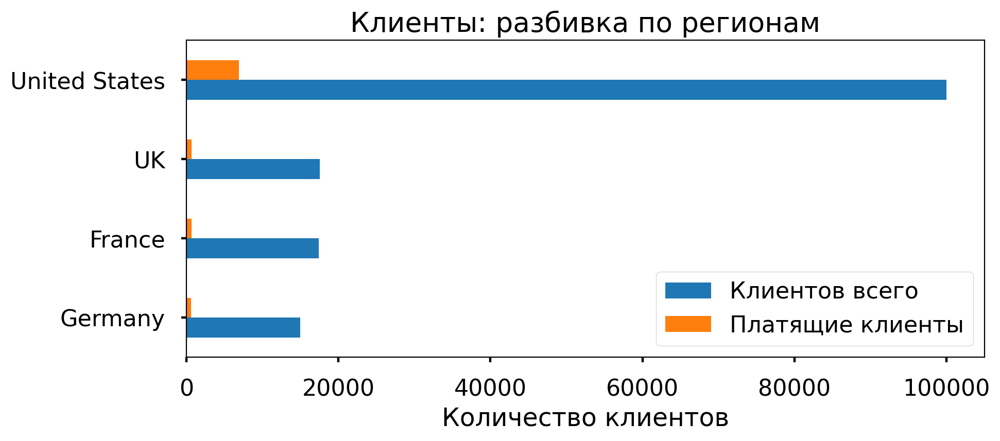

In [32]:
region_users = (
    profiles
    .pivot_table(index='region', values='payer', aggfunc=['count', 'sum', 'mean'])
    .droplevel(1, axis=1)
    .reset_index()
    .rename(columns={'count': 'users', 'sum': 'purchaser', 'mean': 'ratio_purchaser'})
    .sort_values(by='ratio_purchaser', ascending=False)
    .set_index('region')
 )

region_users[['users', 'purchaser']].sort_values(by='users').plot(
    kind='barh', figsize=(10,4), xlabel='', title='Клиенты: разбивка по регионам');
plt.xlabel('Количество клиентов')
plt.legend(['Клиентов всего', 'Платящие клиенты']);

display(region_users.style.format({'ratio_purchaser': '{:.2%}'}))

В `США больше всего платящих клиентов` (и в численном, и в процентном соотношении), в этом регионе в целом находится абсолютное большинство клиентов - чуть более 100.000 пользователей, 6.9% из которых совершают покупку.

Инетерсна ситуация в `Германии` - несмотря на самый малочисленный среди всех регионов приток клиентов (14981 чел.), в процентном соотношении пользователи платят чаще, чем в Великобритании и Франции - `процент покупателей в Германии составляет 4.11%`.

Численные показатели `Великобритании и Франции` достаточно близки друг к другу (17575 и 17450 чел. соответственно), в процентном соотношении в этих странах  `меньше всего платящих клиентов: 3.98% и 3.8%`

### Анализ по устройствам

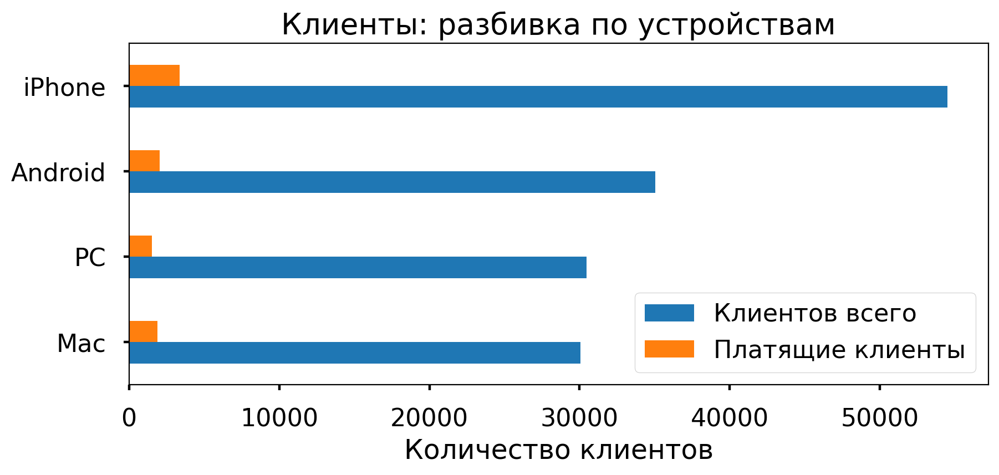

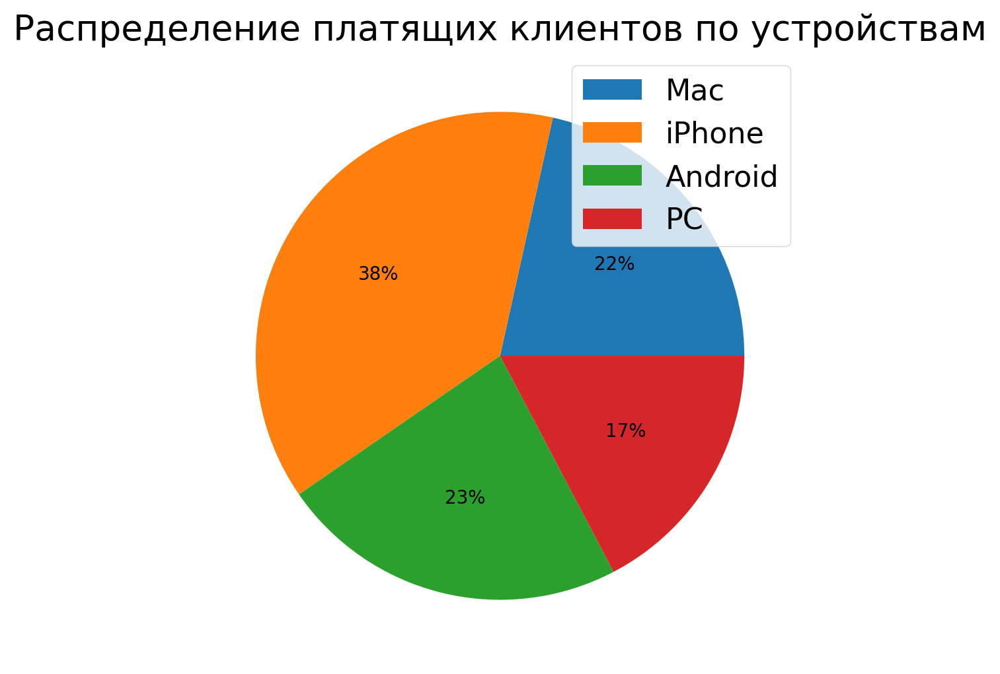

,users,purchaser,ratio_purchaser
device,,,
Mac,30042,1912,6.36%
iPhone,54479,3382,6.21%
Android,35032,2050,5.85%
PC,30455,1537,5.05%


In [33]:
device_users = (
    profiles
    .pivot_table(index='device', values='payer', aggfunc=['count', 'sum', 'mean'])
    .droplevel(1, axis=1)
    .reset_index()
    .rename(columns={'count': 'users', 'sum': 'purchaser', 'mean': 'ratio_purchaser'})
    .sort_values(by='ratio_purchaser', ascending=False)
    .set_index('device')
 )

device_users[['users', 'purchaser']].sort_values(by='users').plot(
    kind='barh', figsize=(10,4), xlabel='', title='Клиенты: разбивка по устройствам');
plt.legend(['Клиентов всего', 'Платящие клиенты']);
plt.xlabel('Количество клиентов')
plt.show()

device_users['purchaser'].plot(kind='pie', 
                                  figsize=(6,6), 
                                  
                                  autopct='%1.0f%%',
                                  label='',
                                 title='Распределение платящих клиентов по устройствам',
                                 labels=None,
                                 legend=False); 
plt.legend(device_users.index);
plt.show()

display(device_users.style.format({'ratio_purchaser': '{:.2%}'}))

`Большинство клиентов пользуются iPhone` (54.479 чел.), самое большое число оплат также совершается пользователями iPhone - 3382, 6.21% от их числа. Однако `в процентном соотношении чаще платят пользователи Mac - 6.36% `при общем числе пользователей 30.042 (самая малочисленная группа)

`Android` используют 35.032 клиента, из них только `5.85% совершают покупки.`

Пользователей `PC` 30.455 чел., эта группа `платит реже всех остальных - только 5.05% `совершили покупку, в численном эквиваленте так же самый низкий показатель: 1537 покупателей.

**Суммарно больше платят владельцы Iphone - 38% от числа всех платящих клиентов, но чаще платят пользователи Мас - 6,36% покупателей от числа всех пользователей Мас**

### Анализ по каналам

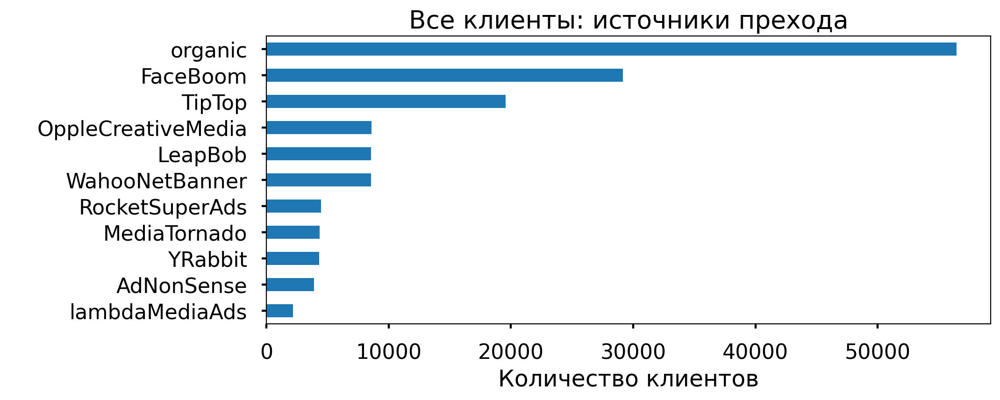

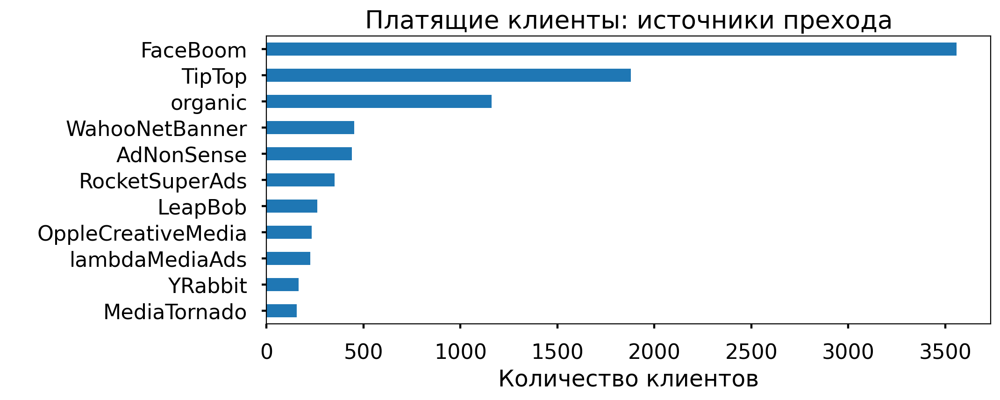

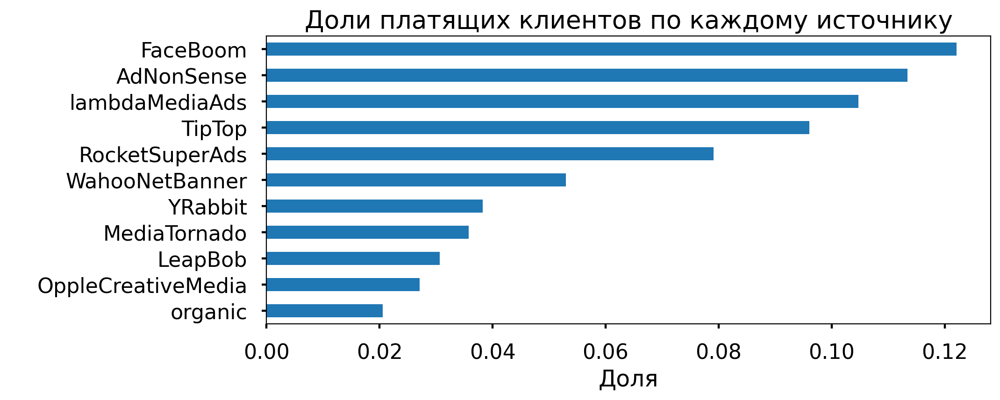

,users,purchaser,ratio_purchaser
channel,,,
FaceBoom,29144,3557,12.20%
AdNonSense,3880,440,11.34%
lambdaMediaAds,2149,225,10.47%
TipTop,19561,1878,9.60%
RocketSuperAds,4448,352,7.91%
WahooNetBanner,8553,453,5.30%
YRabbit,4312,165,3.83%
MediaTornado,4364,156,3.57%
LeapBob,8553,262,3.06%


In [34]:
channel_users = (
    profiles
    .pivot_table(index='channel', values='payer', aggfunc=['count', 'sum', 'mean'])
    .droplevel(1, axis=1)
    .reset_index()
    .rename(columns={'count': 'users', 'sum': 'purchaser', 'mean': 'ratio_purchaser'})
    .sort_values(by='ratio_purchaser', ascending=False)
    .set_index('channel')    
)

channel_users['users'].sort_values().plot(
    kind='barh', figsize=(10,4), xlabel=' ', title='Все клиенты: источники прехода');
plt.xlabel('Количество клиентов')
plt.show()

channel_users['purchaser'].sort_values().plot(
    kind='barh', figsize=(10,4), xlabel=' ', title='Платящие клиенты: источники прехода');
plt.xlabel('Количество клиентов')
plt.show()

channel_users['ratio_purchaser'].sort_values().plot(
    kind='barh', figsize=(10,4), xlabel=' ', title='Доли платящих клиентов по каждому источнику');
plt.xlabel('Доля')
plt.show()

display(channel_users.style.format({'ratio_purchaser': '{:.2%}'}))

Мы уже выявили ранее, что `большинство наших клиентов - "органические"`, сейчас же можем сказать, что это `самая незаинтересованная в покупке` группа (всего чуть более 2% покупателей)

Сосредоточимся на клиентах, перешедших из рекламных источников. `Лучший канал привлечения - FaceBoom`. Большая часть "неорганических" клиентов перешла именно из этого источника, из этих клиентов 12.2% совершили покупку.

Канал `AdNonSense` на втором месте по конвертации пользователей в покупатели: `11.34%` пользователей, перешедших из этого источника совершили покупку, при этом численно канал привел всего 3880 человек.

Замыкает тройку лидеров по конверсии `lambdaMediaAds` - с канала пришло меньше всего человек (2149), но 10.47% из них совершили покупку.

`Выделяющиеся аутсайдеры среди каналов - LeapBob и OppleCreativeMedia`. Каждый из этих двух каналов привели более 8500 пользователей, но проценты покупателей самые низкие - 3.06% и 2.71% соответственно. WahooNetBanner привел столько же клиентов, сколько и LeapBob, но при этом покупателей от первого в полтора раза больше.

### **ВЫВОД**

**Регионы**
- `Абсолютное большинство клиентов - из США (>100.000)`, в этом же регионе больше всего покупателей (и в количественном, и в процентном соотношении - `6.9% совершают покупки`)
- Меньше всего клиентов `в Германии - 14.981 человек,` но совершаются покупки там чаще, чем во Франции и Великобритании - `4,11%` пользователей от общего числа клиентов в регионе
- `Клиенты из Великобритании и Франции совершают меньше всего покупок` - 3.98%  и 3.80% от общего числа клиентов в регионе.

**Устройства**

- `Большинство клиентов пользуются iPhone` (54.479 чел.), `6.21%` из них совершают покупки (3382)
- Чаще всего совершают оплату `пользователи Mac - 6.36%`, несмотря на то, что это самая малочисленная группа (30.042 клиента)
- `Android` используют 35.032 клиента, из них только `5.85% совершают покупки.`
- `Реже всех совершают покупки пользователи РС` - 5.05% покупателей

Анализируя все покупки в целом, суммарно больше платят владельцы Iphone - 38% от числа всех платящих клиентов.

**Каналы**

- `FaceBoom - лучший канал привлечения`, привлек больше всех клиентов - 29.144 из них `12.2%` совершили покупку (также самое большое значение среди всех остальных)
-  потенциально интересные каналы: 
    * `AdNonSense` - клиентов привлек немного, 3880 человек, но среди них `11.34%` совершили покупку ;
    * `lambdaMediaAds` - пришло всего 2149 человек, `10.47%` из которых совершили покупку
- `Аутсайдеры по конверсии: LeapBob и OppleCreativeMedia` - по 8.500+ человек с каждого канала, покупку совершают только 3.06% и 2.71% соответственно

## Маркетинг

* посчитаем общую сумму расходов на маркетинг
* выясним, как траты распределены по рекламным источникам, то есть сколько денег потратили на каждый источник
* построим визуализацию динамики изменения расходов во времени (по неделям и месяцам) по каждому источнику
* узнаем, сколько в среднем стоило привлечение одного пользователя (CAC) из каждого источника, используя профили пользователей


**Вычислим общую сумму расходов на маркетинг:**

In [35]:
total_cost = round(profiles['acquisition_cost'].sum())
print('Общая сумма расходов:', total_cost)

Общая сумма расходов: 105497


Для дальнейших расчетов исключим из всех таблиц "органических" пользователей

In [36]:
profiles = profiles.query('channel != "organic"')
costs = costs.query('channel != "organic"')
visits = visits.query('channel != "organic"')

### Распределение трат по рекламным источникам

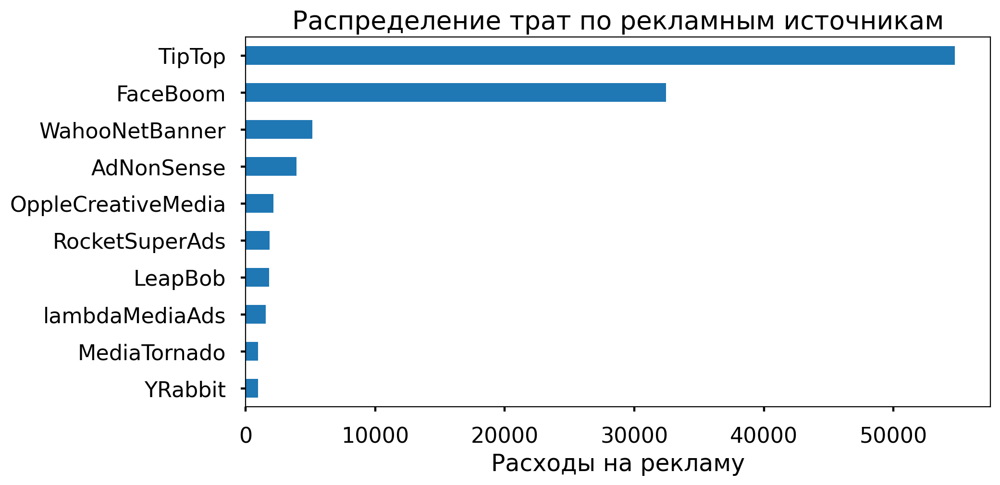

,cost,ratio_cost
channel,,
TipTop,54751.30,51.90%
FaceBoom,32445.60,30.75%
WahooNetBanner,5151.00,4.88%
AdNonSense,3911.25,3.71%
OppleCreativeMedia,2151.25,2.04%
RocketSuperAds,1833.00,1.74%
LeapBob,1797.60,1.70%
lambdaMediaAds,1557.60,1.48%
MediaTornado,954.48,0.90%


In [37]:
channel_costs = (
    profiles
    .groupby('channel')
    .agg({'acquisition_cost':'sum'})
    .rename(columns={'acquisition_cost':'cost'})
    .sort_values(by='cost', ascending=False)
    .reset_index()
    .set_index('channel')
)

#добавим в таблицу столбец с распределениеи суммы расходов по долям
channel_costs['ratio_cost'] = channel_costs['cost'] / total_cost * 100

channel_costs['cost'].sort_values().plot(kind='barh', title='Распределение трат по рекламным источникам', figsize=(10,5))
plt.xlabel('Расходы на рекламу')
plt.ylabel('')
plt.show()
channel_costs.style.format({'ratio_cost': '{:.2f}%', 'cost': '{:.2f}'})

Больше половины трат `(51,9%)`приходится на канал `TipTop`
Треть трат относятся к каналу `FaceBoom - 30.7%`
С огромным отрывом замыкает топ-5 WahooNetBanner, AdNonSense, OppleCreativeMedia - 4.9%, 3.71% и 2.04% соответственно

Траты по остальным каналам не превышают 2% (по каждому)

### Динамика изменения расходов во времени по каждому источнику

Построим графики динамики изменения расходов во времени: по неделям и месяцам

In [38]:
# добавляем новые столбцы с номером недели и номером месяца:
costs['week'] = pd.to_datetime(costs['dt']).dt.isocalendar().week
costs['month'] = pd.to_datetime(costs['dt']).dt.month

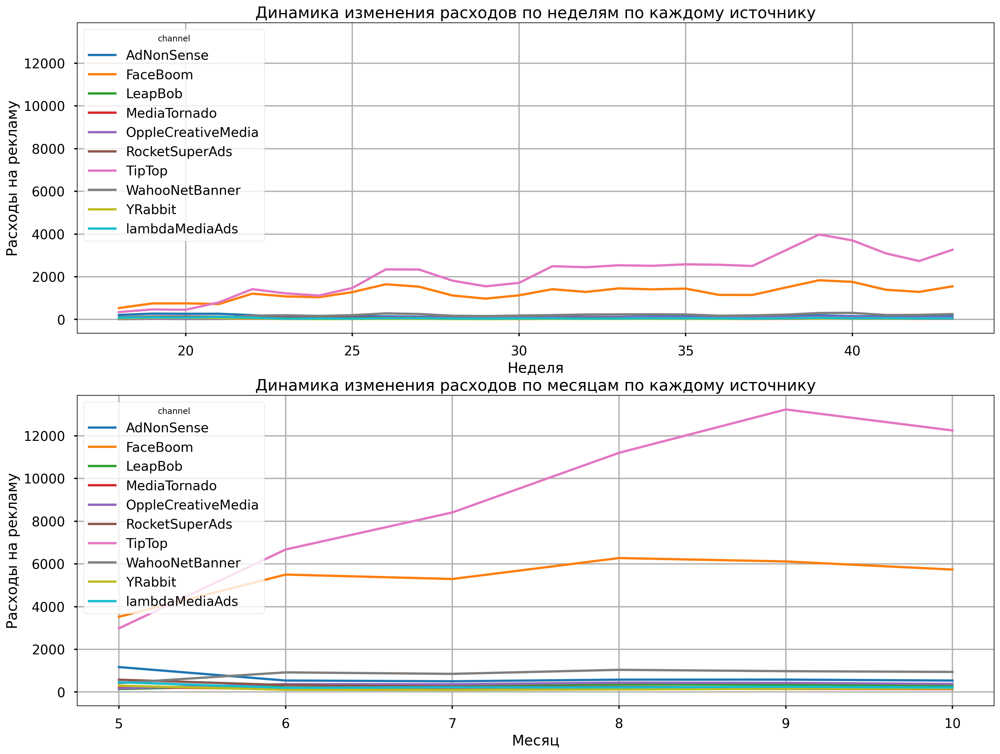

In [39]:
plt.figure(figsize=(20,15))

# график динамики расходов по неделям
ax1 = plt.subplot(2, 1, 1)
costs.pivot_table(
    index='week',
    columns='channel',
    values='costs',
    aggfunc='sum',
).plot(grid=True, ax=ax1)
plt.xlabel('Неделя')
plt.ylabel('Расходы на рекламу')
plt.title('Динамика изменения расходов по неделям по каждому источнику')

#график динамики расходов по месяцам
ax2 = plt.subplot(2, 1, 2, sharey=ax1)
costs.pivot_table(
    index='month',
    columns='channel',
    values='costs',
    aggfunc='sum'
).plot(grid=True, ax=ax2)
plt.xlabel('Месяц')
plt.ylabel('Расходы на рекламу')
plt.title('Динамика изменения расходов по месяцам по каждому источнику')
plt.show()

Видимые изменения расходов характерны только для двух каналов `TipTop и Faceboom`. Траты по всем остальным каналам за весь период практически не меняются - не более ~200  в неделю и не более ~1000 в месяц

Ранее выяснили, что `TipTop и Faceboom - самые затратные каналы`, теперь можем заметить, что траты на канал Faceboom в целом за весь период колеблются около 6000 в месяц, а вот траты на канал `TipTop растут из месяца в месяц`. Если в начале изучаемого периода (в мае) мы расходовали на этот канал около 300, в сентябре траты на рекламу в TipTop уже превышают 12.000. В целом, траты на канал непрерывно растут, наблюдаем небольшой спад к октябрю (данные на этот месяц не полные, только до 27 числа).

По неделям для канала Faceboom наблюдается небольшой разброс трат, но за весь период траты не превышают 2000 в неделю, а траты `TipTop наоборот - начиная с 31 недели на этот канал тратили стабильно больше 2000 в неделю.`


### CAC по каждому источнику

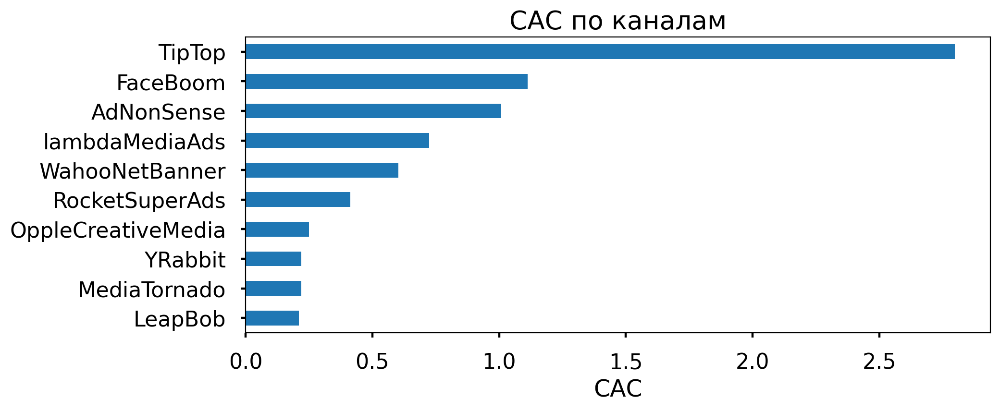

In [40]:
cac_report = (
    profiles
    .groupby('channel')
    .agg({'acquisition_cost':'mean'})
    .rename(columns={'acquisition_cost':'cac'})
    .sort_values(by='cac', ascending=False)
    .reset_index()
    .set_index('channel')
)

cac_report.sort_values(by='cac').plot(kind='barh', title='САС по каналам', xlabel='', figsize = (10,4),legend=False)
plt.xlabel('САС')
plt.show()



`Дороже всего обходятся клиенты из TipTop - CAC = 2.8`. CAC по всем остальным каналам существенно ниже. Посмотрим еще раз сколько клиентов приходят из разных каналов и сравним с САС по каждому каналу

In [41]:
cac_channel = (
    profiles
    .groupby('channel')
    .agg({'acquisition_cost':['mean','sum'],'payer':['count', 'sum','mean']})
    .droplevel(1, axis=1)
    .reset_index()
    .set_index('channel')
)
cac_channel.columns = ['cac', 'total_costs', 'total_clients', 'payer', 'ratio_payer']
cac_channel['total_costs']= cac_channel['total_costs'].astype('int')
total_cac = total_cost / cac_channel['total_clients'].sum()
print('CAC по всем каналам:', round(total_cac, 2))
cac_channel.sort_values(by='cac', ascending=False).style.format({'cac' : '{:.2}', 'ratio_payer':'{:.2%}'})

CAC по всем каналам: 1.13


,cac,total_costs,total_clients,payer,ratio_payer
channel,,,,,
TipTop,2.8,54751,19561,1878,9.60%
FaceBoom,1.1,32445,29144,3557,12.20%
AdNonSense,1.0,3911,3880,440,11.34%
lambdaMediaAds,0.72,1557,2149,225,10.47%
WahooNetBanner,0.6,5151,8553,453,5.30%
RocketSuperAds,0.41,1833,4448,352,7.91%
OppleCreativeMedia,0.25,2151,8605,233,2.71%
YRabbit,0.22,944,4312,165,3.83%
MediaTornado,0.22,954,4364,156,3.57%


При затратах `более 54 тыс. с канала TipTop всего пришло 19561,` отсюда и вытекает высокий САС. Видим, что из этих 19 тыс. клиентов `только 9,6 совершают покупку.` С финансовой точки зрения канал "отработал" плохо. При меньших затратах (32445) `FaceBoom привлек почти на 10 тыс.клиентов больше, которые "сконвертировались" в покупателей на 12.2%.`

Клиенты, перешедшие с `AdNonSense и lambdaMediaAds обходятся еще дешевле - 1 и 0.72 соответственно, но при этом платят чаще,` чем клиенты с TipTop - конверсия по этим двум каналам 11.34% и 10.47%.

Досаточно высокая конверсия у клиентов с канала `RocketSuperAds: 7.91%, при этом САС по этому каналу всего 0.41.`

"Дешевые" клиенты с каналов OppleCreativeMedia, YRabbit, MediaTornado, LeapBob (САС по каждому не превышает 0.25) конвертируются в покупателей хуже всех.

Компании очевидно стоит пересмотреть бюджет на TipTop и `переориентироваться на более конверсионные площадки.`

### Вывод

* **Общие траты на маркетинг составляют 105497**.
* Львиная доля трат приходится на **канал TipTop** - привлечение клиентов с этого канала обходится компании **в 51.9% от общих затрат на маркетинг**, при самом высоком САС **всего 9.6% новых пользователей становятся покупателями**. 
* Ежемесячно **траты на привлечение растут только для канала TipTop**: последние два месяца **траты на канал составляют более 12.000**. Второй по дороговизне **FaceBoom последние месяцы обходится в два раза дешевле, чем TipTop - около 6.000/мес**. 
* Траты по **всем остальным каналам практически не меняются на протяжении всего периода**, каждый из оставшихся каналов обходится не дороже 1000 в мес.
* **Конверсию выше 10%** имеют всего три канала: **FaceBoom, AdNonSense и lambdaMediaAds**. С **FaceBoom пришло больше всего новых клиентов - 29144**, этот же канал имеет **самую высокую конверсию по покупателям (12,2%)**
* Относительно "дешевый" канал **RocketSuperAds** показывает неплохой результат - при САС 0.41 почти **каждый восьмой клиент совершает покупку**. Для сравнения: на канал OppleCreativeMedia суммарно потратили больше, получили вдвое больше клиентов (8605), однако  только 2.71% из всех новых пользователей совершили покупку
* Самые низкозатратные каналы YRabbit и MediaTornado привели >4000 новых пользователей, но при этом покупателей среди них всего 3.83% и 3.57%. С канала LeapBob и WahooNetBanner тоже пришли в основном "неплатящие" пользователи

## Оценка окупаемости рекламы

- проанализируем окупаемость рекламы c помощью графиков LTV и ROI, а также графиков динамики LTV, CAC и ROI
- проверим конверсию пользователей и динамику её изменения. То же самое сделаем с удержанием пользователей. Построим и изучим графики конверсии и удержания
- проанализируем окупаемость рекламы с разбивкой по устройствам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI
- проанализируем окупаемость рекламы с разбивкой по странам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI
- проанализируем окупаемость рекламы с разбивкой по рекламным каналам. Построим графики LTV и ROI, а также графики динамики LTV, CAC и ROI.
- ответим на такие вопросы:
    * Окупается ли реклама, направленная на привлечение пользователей в целом?
    * Какие устройства, страны и рекламные каналы могут оказывать негативное влияние на окупаемость рекламы?
    * Чем могут быть вызваны проблемы окупаемости?

Входные данне: сегодня 1 ноября 2019 года, в бизнес-плане заложено, что пользователи должны окупаться не позднее чем через две недели после привлечения.

### Окупаемость рекламы: графики  LTV и ROI, графики динамики LTV, CAC и ROI

Задаем момент анализа - 1/11/2019 и горизонт в 14 дней:

In [42]:
observation_date = datetime(2019, 11, 1).date()
horizon_days = 14

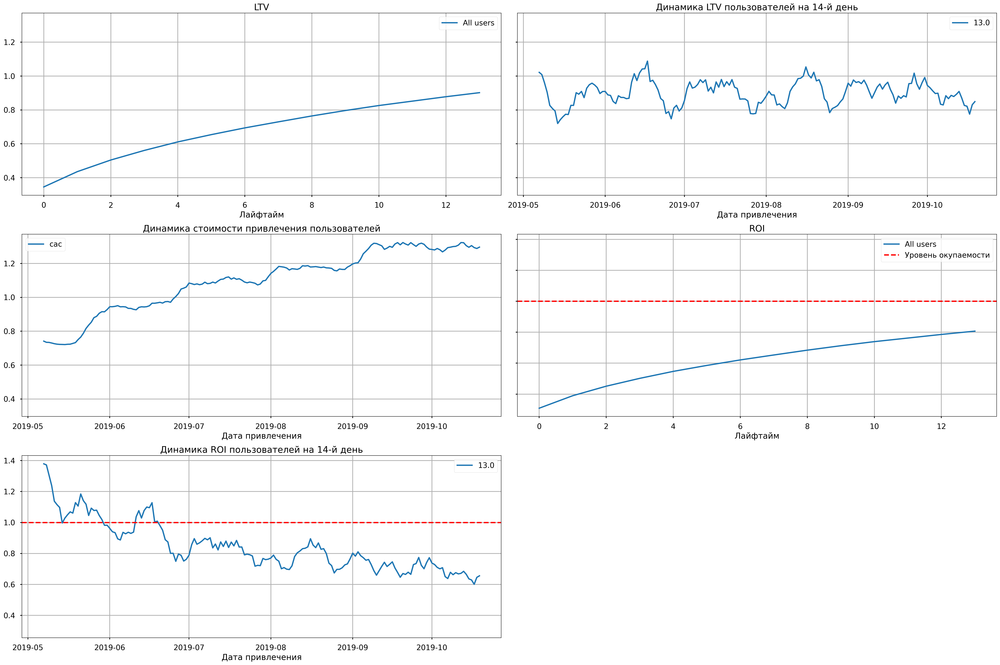

In [43]:
ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles, orders, observation_date, horizon_days
)


plot_ltv_roi(ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days) 

Первое, что стоит отметить - `несмотря на стабильность LTV, этот показатель меньше, чем САС, компания получает от клиента меньше прибыли, чем тратит на его привлечение.`

САС к началу июня резко вырос и продолжает расти, `с каждым месяцем привлечение нового клиента становится дороже`

`ROI не соответствует целям, заявленным в бизнес-плане:` затраты на рекламу не окупаются (ROI к 14-му дню 80%)

Анализируя ROI в динамике: несмотря на некоторые скачки, почти весь май реклама окупалась, но дальше ситуация из месяца в месяц становится хуже. `Начиная с середины июня реклама не окупается, последние два месяца ROI не достигает 80%`

**Вывод**

* **LTV < CAC,** траты на привлечение клиента превышают полученную от него прибыль
* **САС с каждым месяцем растет**, последние два месяца превышает 1.2
* **Затраты на рекламу не окупаются**. ROI на конец 14-го лайфтайма 80%
* **Реклама не окупается с июня и до конца анализируемого периода**

###  Конверсия и удержание

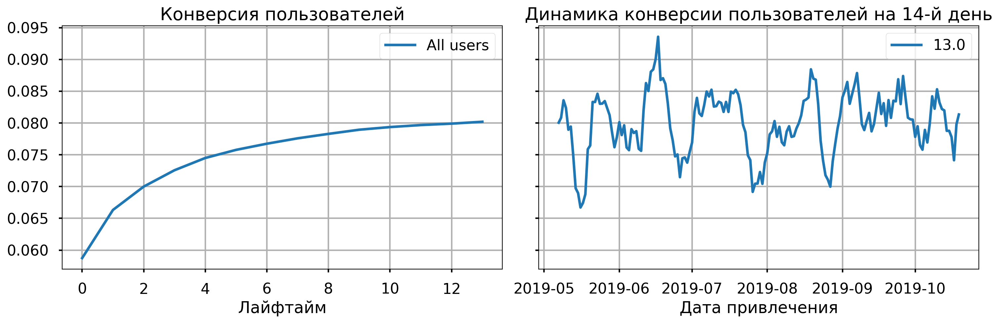

In [44]:
conversion_raw, conversion_grouped, conversion_history = get_conversion(
    profiles, orders, observation_date, horizon_days
)

plot_conversion(conversion_grouped, conversion_history, horizon_days)

На первый день конверсия составляет чуть меньше 6%, плавно растет, но к `14-му лайфтайму конверсия достигает только 8%`

Динамика конверсии сильно скачет, зависит от сезонности.

**Посмотрим на графики удержания:**

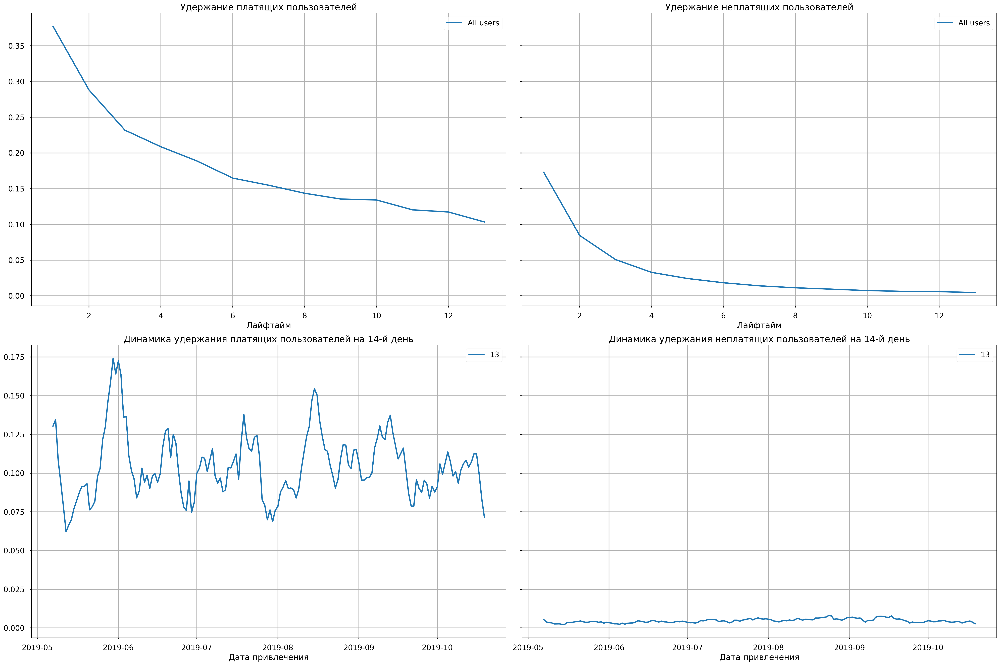

In [45]:
retention_raw, retention_grouped, retention_history = get_retention(
    profiles, visits, observation_date, horizon_days
)

plot_retention(retention_grouped, retention_history, horizon_days) 

Если удержание неплатящих пользователей не сильно удивляет (у клиентов меньше стимула использовать приложение, за которое они не платит), то `для платящих клиентов показатель Retention Rate очень низкий.` Удержание первого дня - около 37%, с каждым днем удержание неизменно спадает, `на 14-й день только 10% продолжают использовать приложение.`

Рассматривая удержание в динамике можем заметить, что в конце мая наблюдался самый высокий процент Retention Rate на 14-й день - около 17.5%, больше такой показатель ни разу не достигался. `Последние полтора месяца удержание на 14-й день не достигало 12.5%.` У неплатящих клиентов этот показатель стабильно низок - не превышает 1%

**Вывод**
* Конверсия на  следующий день после установки - 6%, на 14-й день **конверсия достигает только 8%**
* **Очень низкое удержание** - на 14-й день приложение используют **только 10% платящих пользователей**

### Окупаемость рекламы с разбивкой по устройствам.  Графики LTV и ROI, графики динамики LTV, CAC и ROI

Рассмотрим те же показатели более детально: сначала посмотрим в разбивке по устроуствам

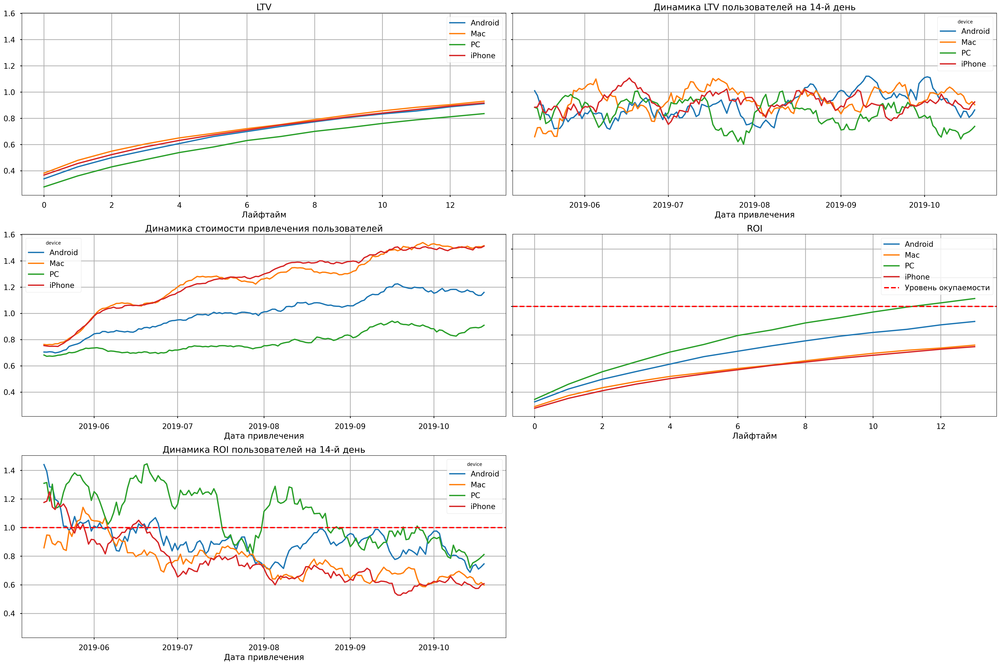

In [46]:
dimensions = ['device']
ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles, orders, observation_date, horizon_days, dimensions=dimensions
)
plot_ltv_roi(
    ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days, window=14
)

`LTV стабилен по всем устройствам,` для PC показатель заметно ниже, чем для остальных устройств.

`САС увеличивается по всем каналам,` пользователи PC обходятся дешевле всех (САС за весь период не превышает 1.0), CAC пользователей Android за последние два месяца составляет около 1.2, а вот `пользователи "яблочной" системы обходятся дороже всего`, затраты на привлечение клиентов, использующих `iPhone и Mac, растут быстрее,` чем для остальных устройств, на сегодняшний день клиенты обходятся `не менее, чем в 1.5`

`Анализируя ROI:` на 14-й лайфтайм реклама окупается только для пользователей PC, однако картина меняется, если смотреть на ROI в динамике. `Последние два месяца на 14-й день не окупаются все пользователи,` и PC в том числе. Более того, можем отметить, что - за редкими исключениями - `затраты на привлечение пользователей iPhone, Mac и Android не окупались за весь исследуемый период. `

Посмотрим дополнительно на Retention Rate по каждому устройству:

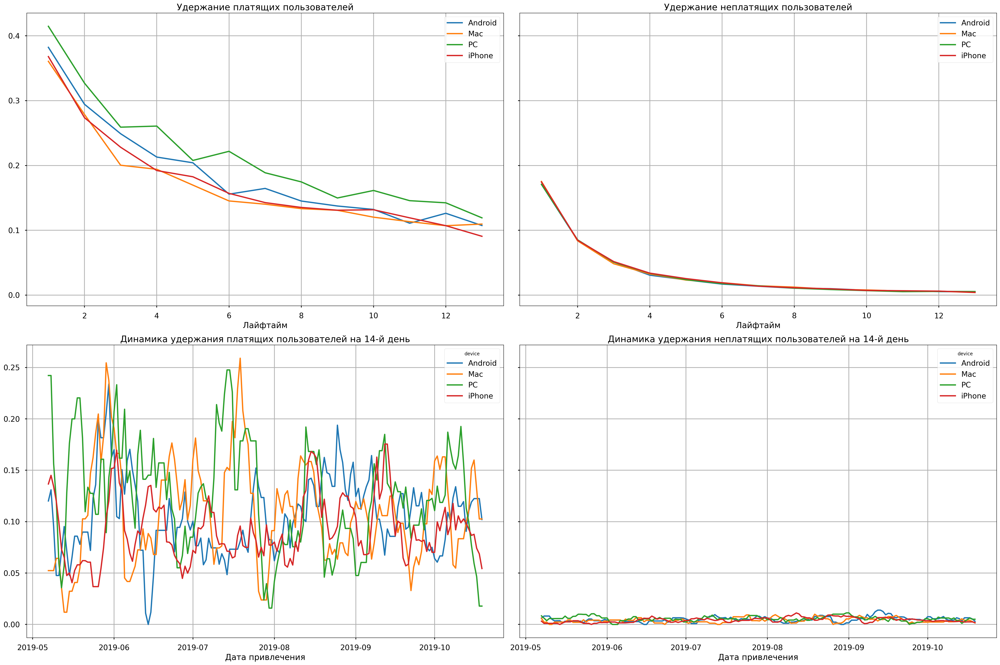

In [47]:
dimensions = ['device']

retention_raw, retention_grouped, retention_history = get_retention(
    profiles, visits, observation_date, horizon_days, dimensions=dimensions
)

plot_retention(retention_grouped, retention_history, horizon_days) 

Динамика удержания платящих пользователей сильно скачет, в среднем, `на 14-й лайфтайм лучше всего удерживаются пользователи  PC (около 12%),` пользователи Android и Mac имеют показатель чуть ниже(11%), `пользователи iPhone удерживаются хуже всех остальных` - на 14-й день приложением пользуются `только 9%` пользователей 

Посмторим на конверсию по каждому устройству:

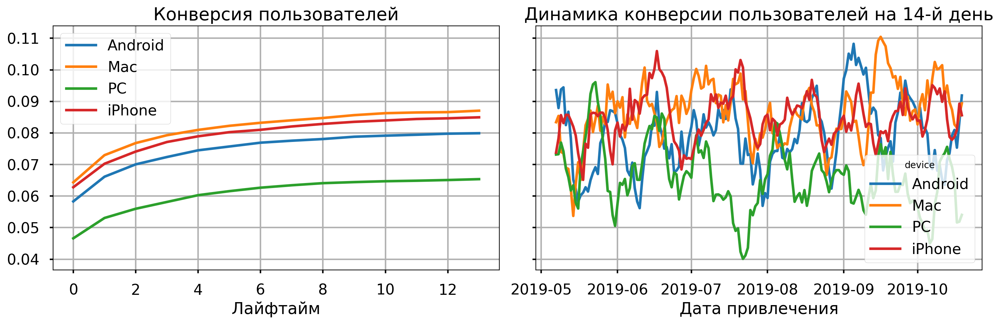

In [48]:
conversion_raw, conversion_grouped, conversion_history = get_conversion(
    profiles, orders, observation_date, horizon_days, dimensions=['device']
)

plot_conversion(conversion_grouped, conversion_history, horizon_days)

`Самая высокая конверсия у пользователей Apple` - на 14-й день после установки приложения совершают покупку почти 9% пользователей Mac и iPhone. Мы уже выявили ранее, что в целом пользователи Apple приносят нам больше дохода, теперь знаем, что клиенты еще и конвертируются лучше остальных, но при этом не удерживаются. `Если пользователи охотно оплачивают подписку, но при этом быстрее остальных забрасывают приложение, основной упор следует сделать именно на удержание`

`Пользователи Android имеют конверсию 8%,` чуть ниже, чем у iPhone и Mac.

`Самая низкая конверсия у PC` - к 14-му лайфтайму покупку совершают ~6.5%. Т.к. пользователи РС хорошо удерживаются, остаются с нами дольше других, здесь лучше `сделать упор на повышение конверсии`.

**Вывод**

* Для всех девайсов характерен рост САС. **САС клиентов, пользующихся Mac и iPhone растет быстрее всех**, на конец анализируемого периода САС для них **выше 1.5**

* На протяжении исследуемого периода лучше всех окупались пользователи РС, **за последние два месяца реклама не окупалась по всем устройствам**. **Пользователи MAC и iPhone не окупались почти весь период**, в целом имеют самые низкие показатели ROI в динамике

* к 14-му дню у **пользователей всех устройств сильно падает удержание**, лучший процент удержания замечен среди пользователей РС (12%), худший - у пользователей iPhone (9%)

* **пользователи Apple имеют самую высокую конверсию - ~9%, пользователи PC - самую низкую (6.5%)**. Учитвая показатели удержания, для Apple стоит проработать именно удержание, а для РС - конверсию.

### Окупаемость рекламы с разбивкой по регионам. Графики LTV и ROI, графики динамики LTV, CAC и ROI

Определили, что дороже всего обходятся пользователи iPhone и Mac, теперь посмотрим на положение дел по регионам:

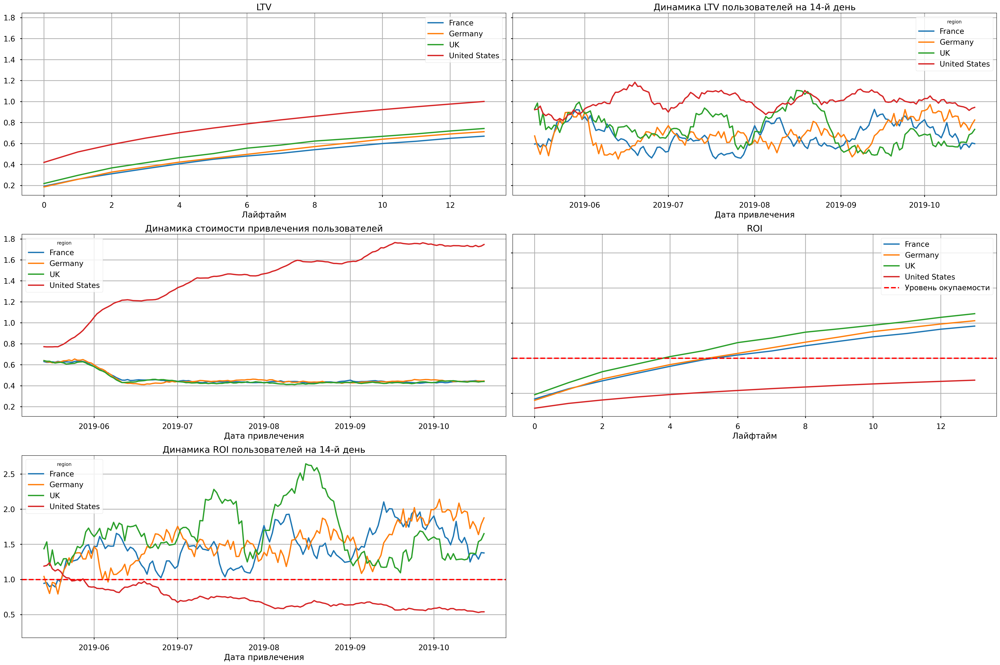

In [49]:
dimensions = ['region']

ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles, orders, observation_date, horizon_days, dimensions=dimensions
)
plot_ltv_roi(
    ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days, window=14
)

Разбивка по регионам дает еще больше информации и интересных наблюдений.

`LTV стабилен для всех регионов, у пользователей из США этот показатель значительно выше` (1.0 на 14-й день, в то время как у всех европейских стран показатель не достигает 0.8), однако `рассматривая LTV в динамике, видим, что для пользователей из США показатель снижается.`

`Анализируя САС,` видим как сильно отличаются траты на маркетинг в США и европейских странах. 

Стоимость привлечения клиентов в европейских странах практически не меняется: в конце мая происходит резкий спад с 0.6  и за весь изучаемый период `САС составляет чуть выше 0.4 (для каждой из трех стран по отдельности.`) 

Кажется, что `все траты компании преимущественно направлены на привлечение американских пользователей:` САС для США растет весь период, последний месяц составляет около 1.7, что в 4.25 больше, чем для любого другого рынка. 

Взглянем дополнительно как менялись траты по странам:

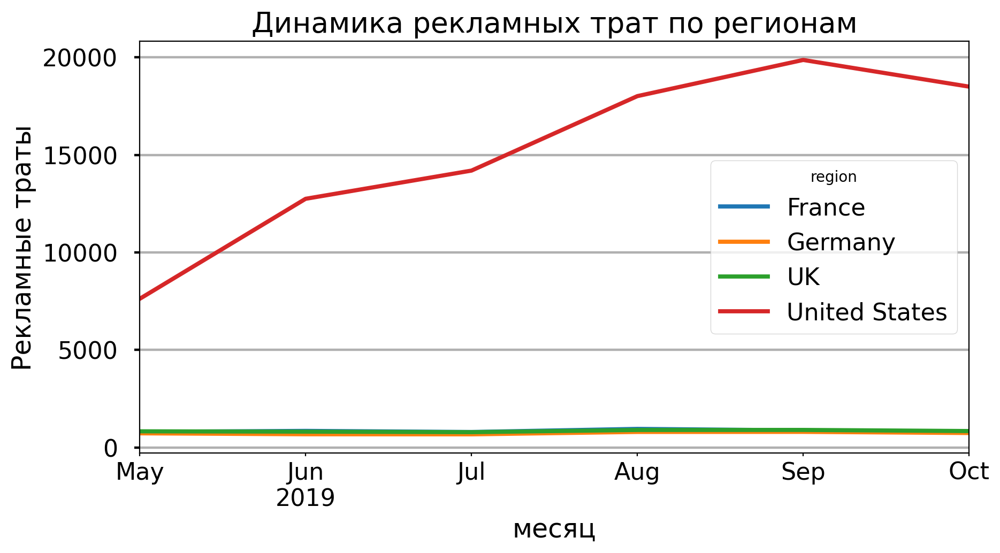

In [50]:
profiles.pivot_table(index='month', columns= 'region', values='acquisition_cost', aggfunc='sum')\
    .plot(figsize=(10,5), title ='Динамика рекламных трат по регионам', xlabel='месяц', grid=True);
plt.ylabel('Рекламные траты');

Выходит, что за весь изучаемый период `траты на рекламу в Великобритании, Франции и Германии оставались неизменными: `компания ежемесячно инвестирует одну и ту же сумму (менее 900 для каждого из этих регионов), рекламные бюджеты для этих регионов не пересматривались. `Весь акцент был сделан на привлечение пользователей из США: бюджет на этот рынок растет каждый месяц, траты на сентябрь составляют 20.000`

В целом при таком распределении не удивляет ROI. `Пользователи из США обходятся компании слишком дорого и не окупаются на 14-й день,` в то время как более "дешевые" клиенты за этот же период окупаются. `Лучший ROI у клиентов из Великобритании.`

В динамике ситуация та же - `клиенты из США не окупаются с июня, пользователи из Великобритании, Германии и Франции практически за весь период  показывют ROI выше линии рентабельности`

Дополнительно проанализируем удержание по регионам:

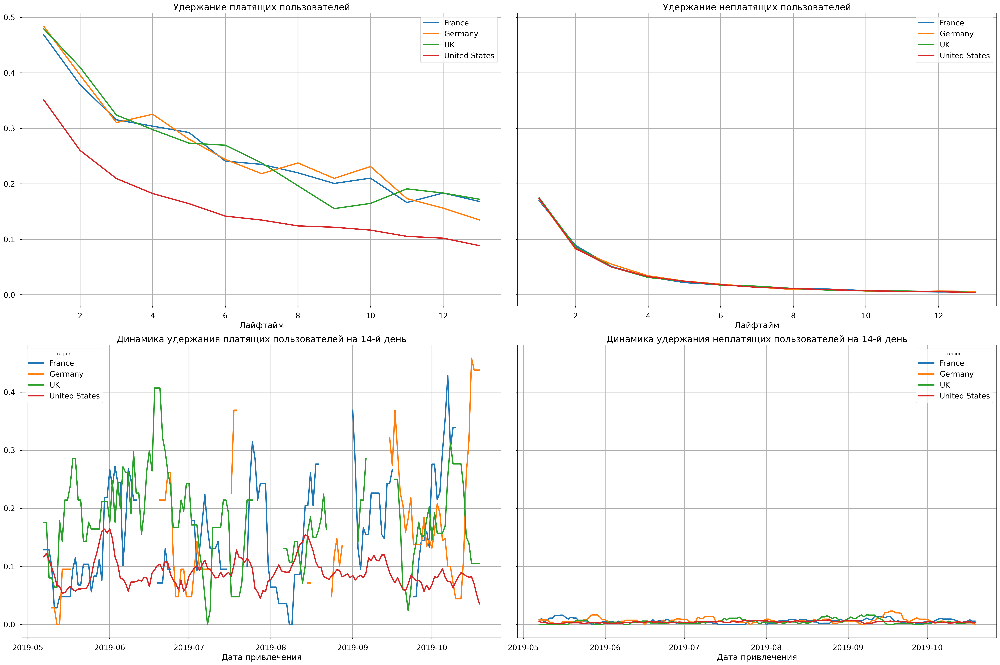

In [51]:
dimensions = ['region']

retention_raw, retention_grouped, retention_history = get_retention(
    profiles, visits, observation_date, horizon_days, dimensions=dimensions
)
plot_retention(retention_grouped, retention_history, horizon_days) 

И здесь пользователи из `США показывают результат хуже, чем у клиентов из Европы.` Уже на первый лайфтайм процент удержания составляет 35%, в то время как у европейских клиентов Retention Rate на этот день около 45%. 

`На 14-й день всего 9% американских клиентов продолжают пользоваться приложением,` когда, например, для пользователей из Великобритании этот показатель достигает 18%.

#### Вывод

* Компания направляет **рекламные бюджеты практически только на американский рынок**: затраты на привлечение пользователей из США в 5 раз больше, чем суммарные затраты на все три европейские страны
* **САС пользователей из США составляет 1.7,** что в 4.25 раз больше, чем для любой европейской страны
* затраты на привлечение пользователей из европейских стран окупаются по каждому региону, привлеченные **клиенты из США не окупаются с июня**
* Сильная концентрация на американском рынке не дает положительных результатов и в удержании пользователей - **только 9% клиентов из США продолжают пользоваться приложением на 14-й день после установки**. У европейских стран Retention Rate выше. 
* LTV > CAC только для европейских стран, **у американских пользователей CAC сильно превышает LTV**

### Окупаемость рекламы с разбивкой по каналам. Графики LTV и ROI, графики динамики LTV, CAC и ROI

Выясним, как обстоит ситуация по каналам привлечения

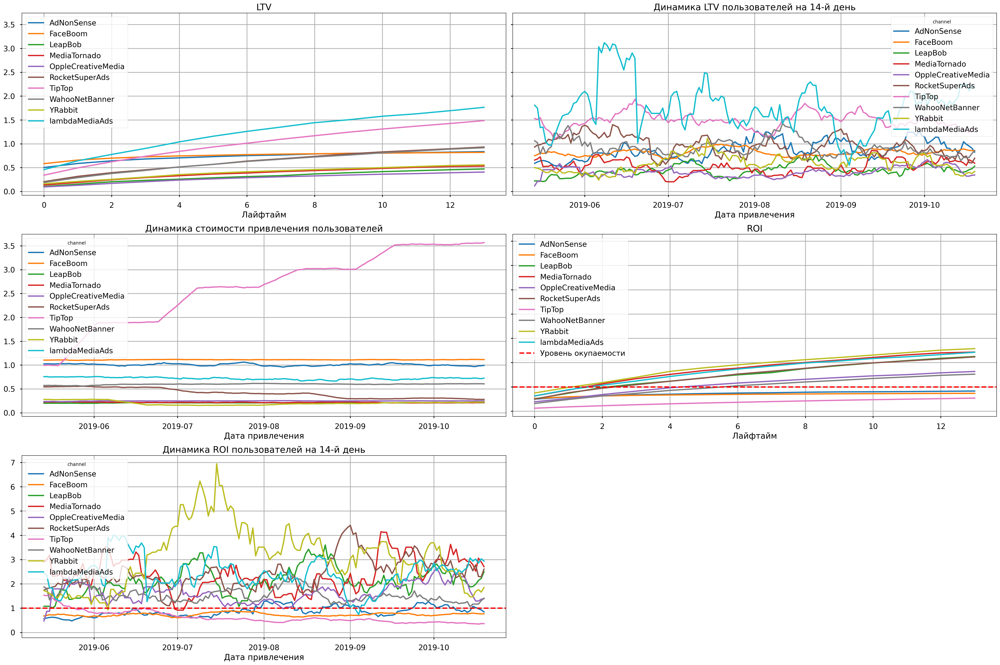

In [52]:
 dimensions = ['channel']
    
ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles, orders, observation_date, horizon_days, dimensions=dimensions
)
plot_ltv_roi(
    ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days, window=14
) 

`Самые высокие показатели LTV у каналов AdNoneSense и TipTop,` но у обоих каналов LTV < СAC.

Видим, что окупаются все каналы, кроме TipTop, FaceBoom и AdNonSense.

График САС напоминает тот же график из блока, где мы рассматривали этот показатель в разбивке по регионам. Если в предыдущем блоке мы обратили внимание, что САС американских пользователей сильно выбивается среди показателей других стран;  то сейчас мы замечаем, что так же `явно выбивается стоимость привлечения клиентов с канала TipTop.`

Очевидно, есть связь между высокими затратами на привлечение клиентов из США и затратами на TipTop. Посмотрим, какие каналы используются для привлечения в разных регионах:

In [53]:
profiles.pivot_table(index='region', columns= 'channel', values='acquisition_cost', aggfunc='sum')\
    .fillna('0').astype('int')

channel,AdNonSense,FaceBoom,LeapBob,MediaTornado,OppleCreativeMedia,RocketSuperAds,TipTop,WahooNetBanner,YRabbit,lambdaMediaAds
region,,,,,,,,,,
France,1376,0,628,0,747,0,0,1789,0,535
Germany,1229,0,529,0,640,0,0,1552,0,471
UK,1305,0,639,0,763,0,0,1808,0,551
United States,0,32445,0,954,0,1833,54751,0,944,0


`Каналы привлечения в Европе и США не пересекаются. `

Во Франции, Германии и Британии клиенты привлекаются с помощью каналов AdNonSense, LeapBob, OppleCreativeMedia, WahooNetBanner и lambdaMediaAds.

В Америке источники привлечения: каналы FaceBoom, MediaTornado, RocketSuperAds, TipTop и YRabbit.

Теперь мы можем считать, что `большие вложения в TipTop = большие вложения в США. Не окупаются инвестиции в TipTop => не окупаются привлеченные пользователи из США => не окупается реклама в целом.`

Т.к. в Европе и США для привлечения используются разные каналы, построим графики LTV, CAC и ROI по каналам отдельно для американского и европейских рынков: так мы их рассмотрим детальнее и выявим проблемные зоны для каждого региона

#### США: окупаемость рекламы с разбивкой по каналам

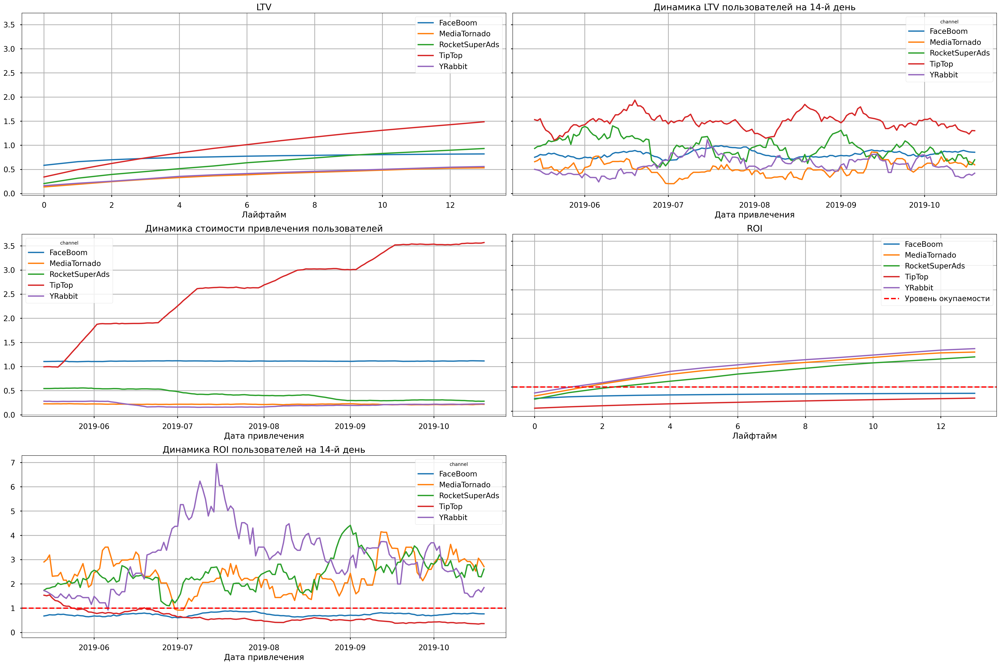

In [54]:
dimensions = ['channel']
#срез по US:
ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles.query('region == "United States"'), orders, observation_date, horizon_days, dimensions=dimensions
)
plot_ltv_roi(
    ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days, window=14
) 

В США самый высокий LTV у пользователей, привлеченных с TipTop, при этом `LTV ниже CAC  более чем в 2 раза. Мы не зарабатываем на клиентах с TipTop`.

По всем каналам стоимость привлечения держится примерно на одном уровне, `клиенты из TipTop обходятся не только дороже, чем клиенты из всех остальных каналов, но эти затраты растут из месяца в месяц`. С середины сентября `САС для TipTop составляет около 3.5,` в то время как САС для второго по стоимости FaceBoom чуть выше 1.0. Стоимость привлечения по всем остальным каналам стабильно низкая.

`"Дорогой" Tip Top не окупается: пользователи не приносят необходимый доход к 14-му дню.` Так же `не окупаются пользователи, пришедшие с каналов lambdaMediaAds и FaceBoom` - оба канала имеют относительно высокий САС, `пользователи из остальных каналов через две недели окупаются.`


В целом, оба самых затратных канала `TipTop и FaceBoom не окупаются`. Рассматривая ROI в динамике, оба канала не окупаются весь исследуемый период. Динамика  lambdaMediaAds колеблется, в целом всегда около линии окупаемости. `Все остальные каналы в динамике окупаются`

**Посмотрим как распределены траты по каналам в каждом из регионов:**

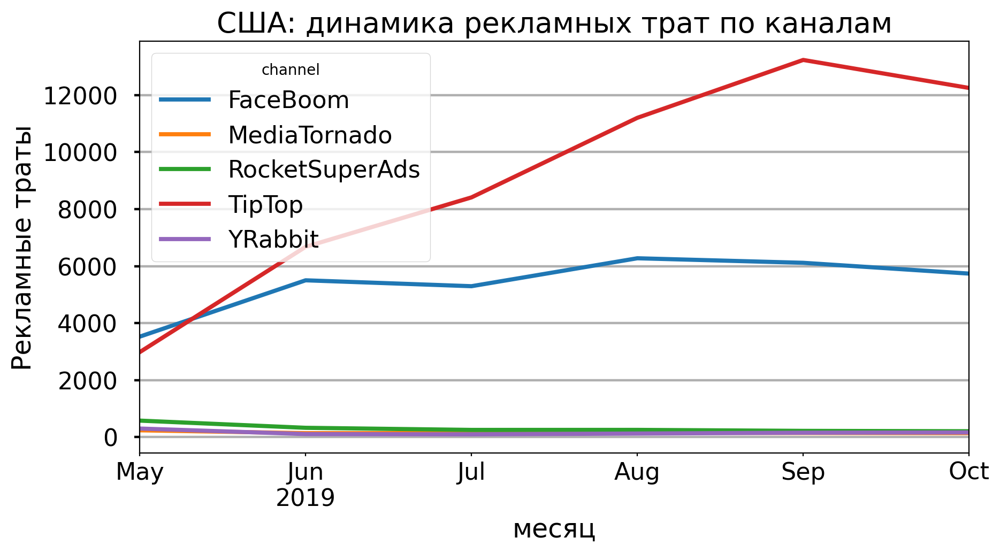

In [55]:
profiles.query('region == "United States"').pivot_table(index='month', columns= 'channel',
                                                        values='acquisition_cost', aggfunc='sum')\
    .plot(title ='США: динамика рекламных трат по каналам', xlabel='месяц', figsize=(10,5),grid=True);
plt.ylabel('Рекламные траты')
plt.show() 


Подтверждаем, что рост затрат на привлечение  клиентов из США напрямую связан с вложениями в рекламу на канале TipTop - бюджеты на рекламу ежемесячно растут только для этого канала.

` Компания  слишком много инвестирует в TiPTop, не получает достаточное число платящих пользователей, отсюда такой высокий САС`.

Бюджеты по всем остальным каналам практически не пересматривались за весь период, очевидно, был взят курс на TipTop, а траты по остальным каналам оставались весь период на одном и том же зафиксированном уровне. 

**Посмотрим дополнительно на конверсию по каждому каналу:**

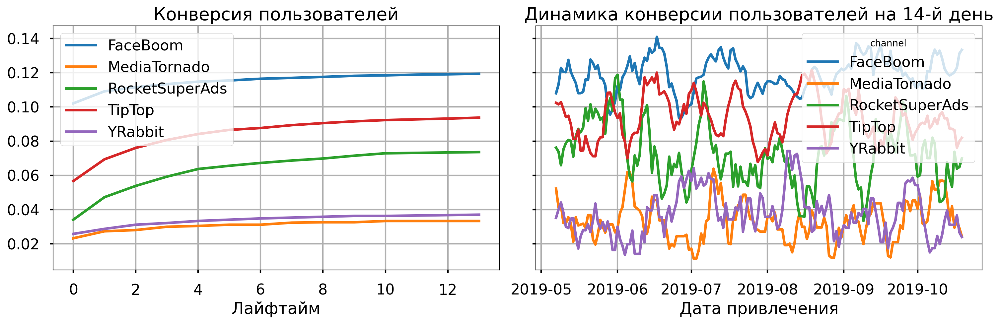

In [56]:
conversion_raw, conversion_grouped, conversion_history = get_conversion(
    profiles.query('region == "United States"'), orders, observation_date, horizon_days, dimensions=['channel']
)
plot_conversion(conversion_grouped, conversion_history, horizon_days)

Самая высокая конверсия на 14-й день у Faceboom (12%), TipTop (9%), RocketSuperAds показывает результат похуже (7.91%).

Как обстоят дела с удержанием?

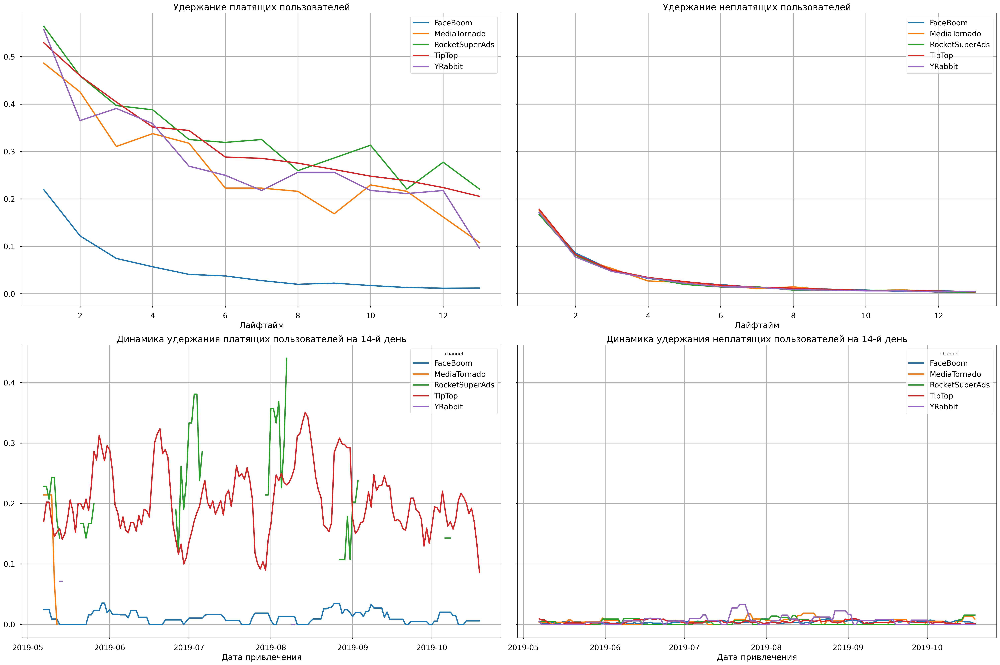

In [57]:
dimensions = ['channel']
retention_raw, retention_grouped, retention_history = get_retention(
    profiles.query('region == "United States"'), visits, observation_date, horizon_days, dimensions=dimensions
)
plot_retention(retention_grouped, retention_history, horizon_days) 

`Faceboom выбивается в худшую сторону - на следующий день после установки приложения заходит чуть больше 20% новых пользователей, через две недели приложением пользуется только 2%.` Рассматривая динамику Retention Rate, видим, что для всех каналов характерны сильные скачки, в то время как пользователи из Faceboom стабильно теряют интерес к 14-му дню использования приложения, более низкие значения не встречаются ни по одному из каналов.

`Лучше всех к 14-му дню удерживаются пользователи, перешедшие с RocketSuperAds` - около 22% продолжают пользоваться приложением, при относительно высокой конверсии в 7.91% - достаточно неплохой результат

#### Европа: окупаемость рекламы с разбивкой по каналам

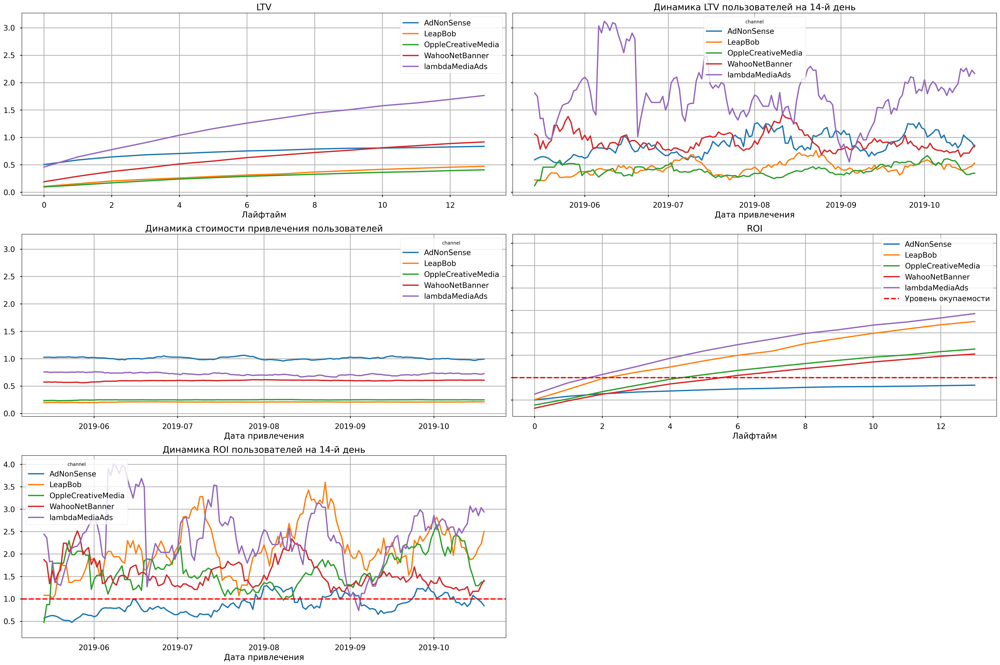

In [58]:
dimensions = ['channel']
#срез по европейским сртранам:
ltv_raw, ltv_grouped, ltv_history, roi_grouped, roi_history = get_ltv(
    profiles.query('region != "United States"'), orders, observation_date, horizon_days, dimensions=dimensions
)
plot_ltv_roi(
    ltv_grouped, ltv_history, roi_grouped, roi_history, horizon_days, window=14
) 

Кажется, в клиентах из Европы мы заинтересованы в куда меньшей степени. `САС в динамике по каждому каналу находится примерно на одном и том же уровне`.

LTV стабилен по всем каналам, рост к 14-му дню `лучше всех выражен у клиентов с канала lambdaMediaAds:` 1.75 против САС около 0.75. 

`Дороже всех обходятся клиенты с AdNonSense - САС чуть выше 1.0, этот же канал единственный из всех не окупается.`

В динамике  `самый высокий ROI у клиентов с канала lambdaMediaAds.`

**Посмотрим на конверсию по каждому каналу:**

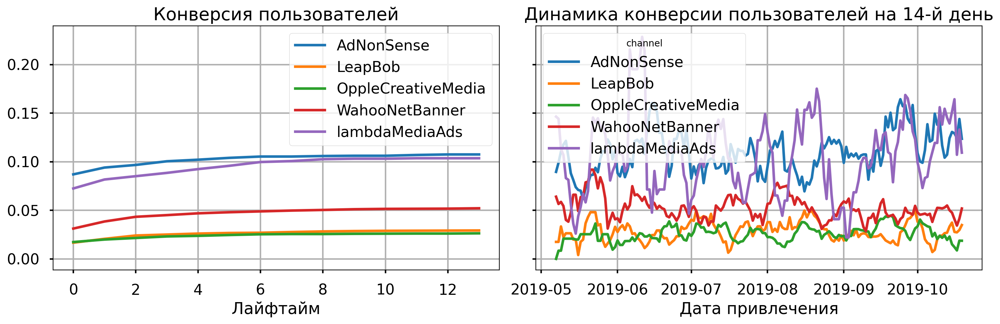

In [59]:
conversion_raw, conversion_grouped, conversion_history = get_conversion(
    profiles.query('region != "United States"'), orders, observation_date, horizon_days, dimensions=['channel']
)
plot_conversion(conversion_grouped, conversion_history, horizon_days)

У большинства каналов конверсия выходит на плато на 2-4 день. Конверсия выше 10% только у двух каналов: AdNonSense и lambdaMediaAds. Учитывая, что клиенты из AdNonSense обходятся нам дорого и не окупаются, `lambdaMediaAds - самый привлекательный источник: лучшая окупаемость + хорошая конверсия.`

Пользователи, пришедшие с WahooNetBanner обходятся нам не сильно дешевле, чем клиенты с lambdaMediaAds, но при этом конвертируются в покупателей намного слабее - `всего 5% к 14-му дню` свершают покупку.

`"Дешевый трафик" с каналов OppleCreativeMedia и LeapBob конвертируется в покупателей хуже всех` - с этих каналов получаем достаточное число новых клиентов, которые, увы, не совершают покупок.

**С каких каналов приходят клиенты, которые дольше всех продолжают пользоваться приложением?**

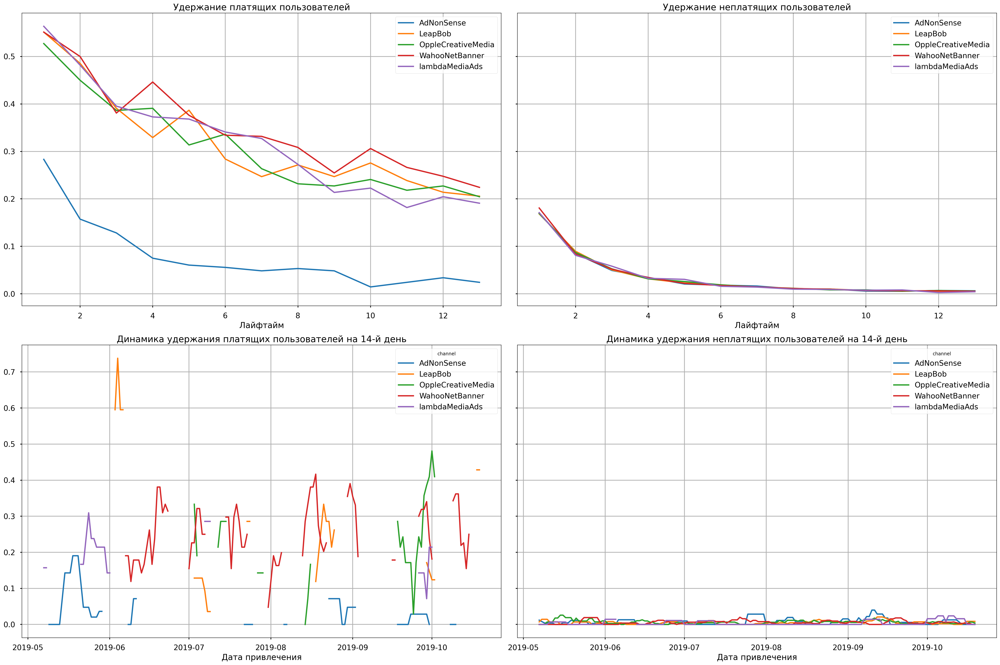

In [60]:
retention_raw, retention_grouped, retention_history = get_retention(
    profiles.query('region != "United States"'), visits, observation_date, horizon_days, dimensions=['channel']
)
plot_retention(retention_grouped, retention_history, horizon_days) 

Клиенты с `AdNonSense` в Европе похожи на клиентов с FaceBoom в США: быстро и чаще других совершают покупку, но теряют весь интерес к приложению через 2 недели. `Уже на первый лайфтайм удержание составляет меньше 30%, к 14-му дню приложение открывают меньше 5%.`

Платящие пользователи из остальных источников удерживаются намного лучше: на следующий день после установки в приложение заходят больше половины новых клиентов, к концу недели процент удержания около 20. 

`Лучше всех удерживаются клиенты с  WahooNetBanner - спустя две недели после установки приложением продаолжают пользоваться порядка 22% клиентов`

### Вывод

Глобально: **реклама не окупается.**
* LTV < CAC, на привлечение клиента мы тратим больше, чем зарабатываем от него
* **Непрерывный прирост САС**, к концу исследуемого периода один клиент обходится **дороже 1.2**
* **ROI на конец 14-го лайфтайма 80%**
* Маркетинговые траты **не окупаются с июня**

Анализ по устройствам:
* **Дороже всех **обходятся клиенты, пользующиеся техникой Apple: **САС по iPhone и Mac >1.5**
* **Пользователи iPhone и Mac не окупаются весь исследуемый период**. Последние два месяца не окупаются пользователи всех устройств
* Лучше всего удерживаются клиенты с РС (12%), хуже всего - пользователи iPhоne(9%)

**В большей степени следует обратить внимание на распределение трат по регионам и каналам**

Для США и Европы используются разные источники привлечения, поэтому логичнее рассматривать рынки отдельно.

**США:**
* на американский рынок уходит бОльшая часть всего рекламного бюджета, соотношение трат США/Европа - 5/1
* **пользователи из США не окупаются, САС 1.7,** что более чем в 4 раза больше, чем для любой европейской страны
* очень слабое удержание - **только 9% клиентов используют приложение на 14-й день**
* больше половины рекламного бюджета уходит на канал TipTop, при этом:
    * приходит **много неплатящих клиентов:** покупку совершает меньше 10%
    * **один новый клиент обходится очень дорого**: последние два месяца САС около 3.5
    * **компания не зарабатывает на клиентах** с этого канала, реклама не окупается с июня
* второй по числу рекламных затрат **FaceBoom тоже не окупается.** Пользователи с FaceBoom часто платят за подписку, но при этом не остаются с нами на долго: **только 2% клиентов пользуются приложением на 14-й лайфтайм**
* Рекламные затраты растут только для канала TipTop, бюджеты на маркетинг для остальных каналов не пересматривался весь период

Основная проблема окупаемости: **больше 80% бюджета уходит на TipTop и FaceBoom, доход с этих каналов не покрывает расход.**

**Европа:**

* относительно американского рынка тратится гораздо меньше средств на привлечение. САС по каждому источнику не меняется в течение всего периода
* в целом, **клиенты из европейских стран окупаются**. Рассматривая каналы привлечения:
    * не окупаются клиенты с AdNonSense (самый высокий САС среди каналов - 1.0)
    * клиенты, перешедшие с других каналов окупаются
    * **lambdaMediaAds** - приносит больше платящих клиентов, так же пользователи, перешедшие с этого канала удерживаются лучше всех (22% на 14-й день)
* Трафик с каналов OppleCreativeMedia и LeapBob обходится очень дешево, при этом клиенты из этих источников не конвертируются в покупателей.

## Выводы

Обработано и проанализировано 309901 наблюдение о посещениях сайта, 40212 заказов и 1800 строк с информацией о расходах. Данные относятся к периоду  1.05.2019 по 27.10.2019.  Все данные предобработаны и приведены к корректному типу. Заданы и применены функции для расчета и анализа бизнес-показателей.

Проведены исследовательский и маркетинговый анализы, оценена окупаемость рекламы.

### Исследовательский анализ данных

**Регионы**
* Большинство наших клиентов из **США: 100.002, из них 6.9% совершают покупку** 
* В странах Европы пользователей значительно меньше:
    * Германия - 14981, конверсия 4.11%
    * Великобритания - 17575, конверсия 3,98 %
    * Франция - 17450, конверсия 3.8 %

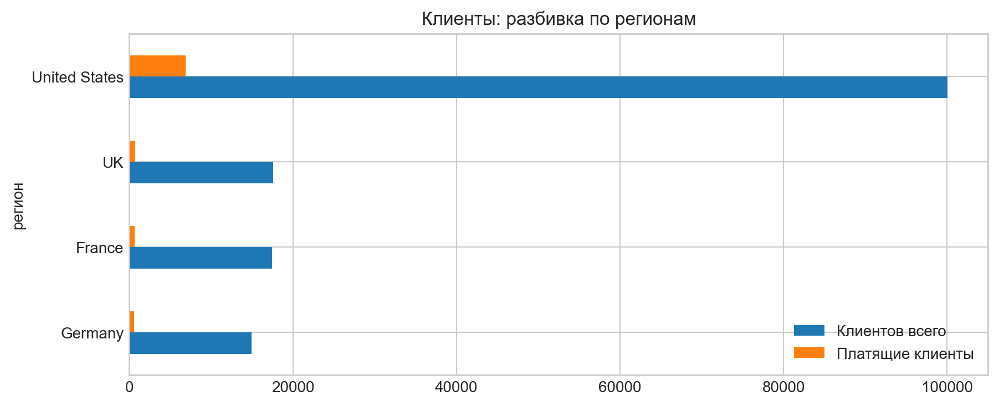

**Устройства**
* Большинство клиентов пользуется **iPhone - 54.479 чел, из них совершают покупку 6.21%**
    * Android используют 35.032 чел., конверсия 5.85%
    * Mac используют 30.042 чел., конверсия 6,36%
    * PC используют 30.455 чел., конверсия 5.05%
* **Суммарно больше платят владельцы Iphone - 38%** от числа всех платящих клиентов, но **чаще платят пользователи Мас - 6,36%** покупателей от числа всех пользователей Мас

**Каналы привлечения**
* Абсолютное большинство пользователей приходят к нам органически, однако при этом "органики" совершают ничтожно мало покупок.
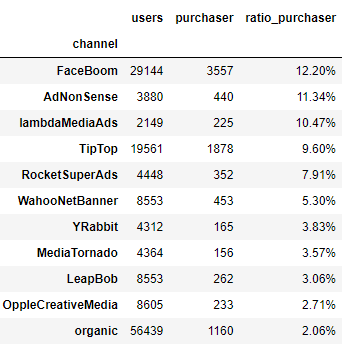
* Платный трафик:
    * больше всего получили клиентов от канала **Faceboom,** процент конвертации: 12.2%
    * **TipTop** принес 19561 клиента, из них 9.6% совершили покупку
    * с каналов WahooNetBanner, LeapBob и OppleCreative получили > 8.000 клиентов с каждого, однако пользователи редко совершают покупки
    * Высокая конвертация у пользователей с канала **AdNоnSense**: 11.34% совершают покупку, при этом всего клиентов получили немного, 3880
    * RocketSuperAds привлек 4448 клиентов, конвертация 7.91%
    * YRabbit и MediaTornado - аутсайдеры и по числу привлеченных клиентов, и по совершенным среди них покупок
    
### Маркетинг

* Общая сумма расходов на маркетинг: **105497**
* **Больше половины бюджета тратится на канал TipTop**, 30% на Faceboom. Траты на все остальные каналы существенно ниже
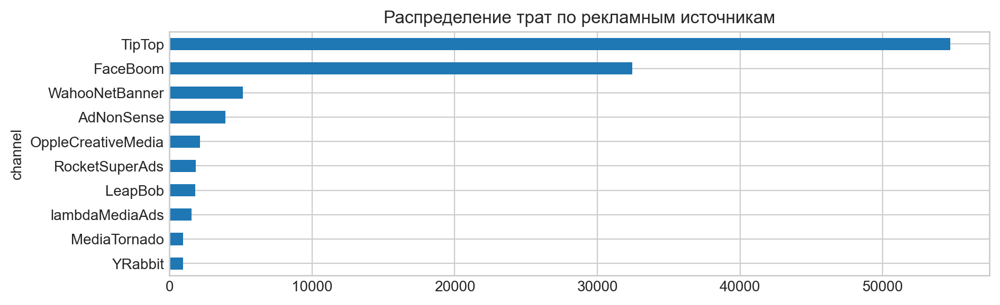

* **сильно растут затраты на TipTop** - последние два месяца траты превышают **12.000, это в 400 раз больше**, чем в затраты на канал в мае. Второй по дороговизне Faceboom обходится в ~6.000/мес, траты по всем остальным каналам не превышают 1.000/мес

* **Дороже всего обходятся клиенты с TipTop: САС 2.8**. С канала пришло 54751 человек из них только 9.6% совершили покупки.
    * Каждый клиент с **Faceboom** обходится нам в 1.1, при этом клиенты с этого канала лучше всех конвертируются в покупателей (12.2% совершают покупку)
    * Клиенты с **AdNonSense** обходятся чуть дешевле, но приток новых пользователей существенно ниже - 3911 человек. Конверсия при этом хорошая, 11.34%
    * "Дешевый" трафик с каналов OppleCreativeMedia, YRabbit, MediaTornado и LeapBob **приводит много неплатящих клиентов** - конверсия по этим каналам самая низкая
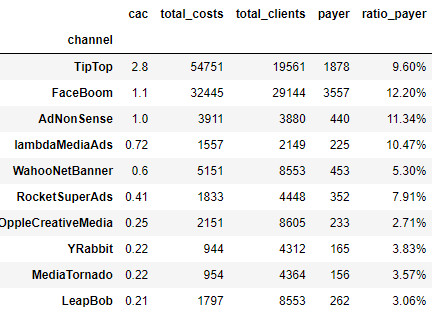

### Оценка окупаемости рекламы:

**Глобально - реклама не окупается**:

* LTV < CAC: **клиенты приносят денег меньше, чем мы тратим на их привлечение**
* с июня **САС резко вырос и продолжает расти**, привлечение нового клиента обходится из месяца в месяц **дороже**
* **ROI к 14-му дню: 80%**. Вслед за июньским ростом САС, реклама не окупается с этого же месяца
* конверсия к 14-му дню: 8%, удержание: 10%

Такова общая картина, для поиска проблемных зон проведен более детальный анализ.

**Анализ устройств**


* **дороже всего обходятся клиенты, пользующиеся техникой Apple**. На конец периода САС пользователей iPhone и Mac > 1.5
* CAC растет по всем устройствам, опять же, для iPhone и Mac - рост более резкий
* Реклама не окупается по всем устройствам. За весь период высокий ROI только у пользователей PC, но анализируя динамику, замечено, что **последние два месяца не окупается реклама по всем устройствам,** PC  в том числе. Затраты на привлечение пользователей iPhone, Mac и Android не окупались практически весь исследуемый период.
* ЛУчшее удержание у пользователей PC (12%), худшее - у клиентов с iPhone(9%)

Не стоит делать бо'льший акцент на результаты по устройствам, **основная причина неокупаемости рекламы выявлена в анализе по регионам и каналам привлечения**

Всего мы запускаем рекламу по 10-ти различным каналам, однако **каналы для США и Европы - разные**,  лучше рассматривать все показатели в связке "страна-каналы привлечения". 

Выявили, что **нерентабельность рекламных затрат практически полностью связана с неуспехом в привлечении американских пользователей**.

**США**:

Реклама для американских пользователей запускается по пяти каналам: TipTop, FaceBoom, RocketSuperAds, YRabbit и MediaTornado. **Больше 80% рекламных затрат на все регионы приходятся на привлечение с канала TipTop и FaceBoom,** следовательно, на привлечение пользователей из США. 
Бюджеты на каналы RocketSuperAds и YRabbit можно назвать фиксированными - компания на протяжении всего периода вкладывает примерно одну и ту же небольшую сумму на привлечение клиентов из этих каналов. Траты на FaceBoom немного колеблются, но в целом затраты составляют ~6.000  в месяц. **Траты на TipTop все время увеличиваются и на конец изучаемого периода инвестируем в этот канал более 12.000 в месяц.**

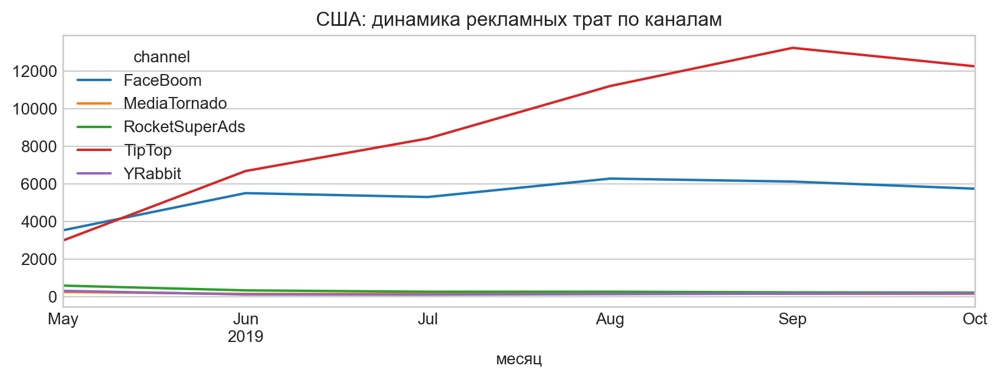

Бо'льшая часть бюджета ушла на TipTop, траты на канал все время растут, но новые клиенты не привлекаются с той же скоростью, с какой мы увеличиваем бюджет. Достаточно взглянуть на рост САС по TipTop:

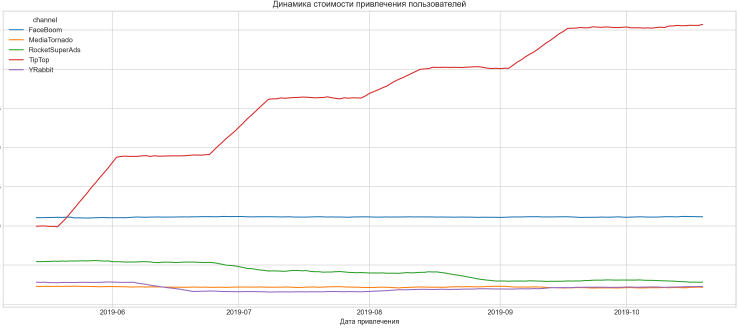

Новые клиенты с этого канала обходятся все дороже и дороже, при этом посмотрим на ROI:

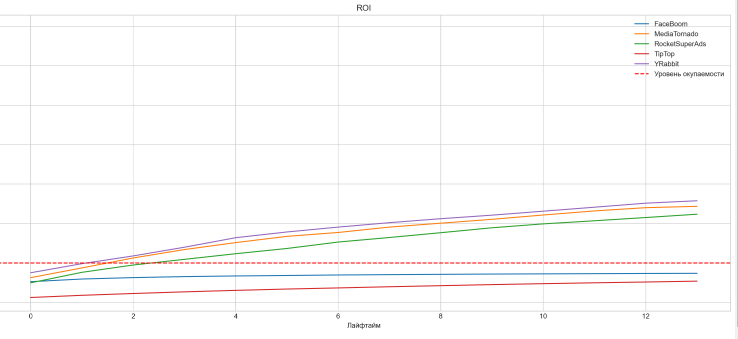

**TipTop не окупается.** Не окупается так же FaceBoom, на который мы тратим 30% от общего бюджета.

**Не окупаются самые затратные площадки (TipTop и FaceBoom) => не окупается самый большой рынок (США) => не окупается реклама в целом**. Это и есть основная причина неэффективности маркетинга.

Неэффективность этих двух площадок отражается на анализе американских клиентов в целом. Хотя LTV в США выше, чем в остальных регионах, САС составляет 1.7, что в несколько раз больше LTV. **Мы не зарабатываем на клиентах из США,** ROI расположен далеко за чертой окупаемости. 

**Анализ по каналам и рекомендации:**
* **TipTop**:
        * LTV выше, чем у других каналов, при этом в два раза ниже, чем САС, **мы не зарабатываем на клиентах с TipTop**
        * Не окупается на 14-й день
        * Конверсия на 14-й день ~9%
        * Достаточно хорошее удержание в сравнении со всеми остальными каналами - 20% продолжают пользоваться приложением спустя две недели
        
**Рекомендация:** Сократить бюджет. Провести оптимизацию рекламных компаний: с канала пришло 19561 клиентов, из них совершают покупку только 9.6% - на ту ли аудиторию мы таргетируемся? Возможно проведение промоакций, пересмотр стоимости подписки.
        
* **FaceBoom**
        * CАС 1.0, при этом **мы не зарабатываем на клиентах**
        * самая высокая конверсия - 12.2%, при этом самое плохое удержание - 98% перестают использовать приложение на 14-й день
        
**Рекомендация:** аналогично TipTop, провести оптимизацию рекламных кампаний. Пользователи достаточно охотно оплачивают подписку, при этом перестают пользоваться приложением, соответственно, перестают платить. Соответствует ли реклама продукту? Необходимо выявить, что отталкивает в дальнейшем использовании приложения

* **RocketSuperAds**
        * **клиенты окупаются**, при тех не меняющихся рекламных затратах, САС имеет тенденцию к снижению.
        * привлек 4448 клиентов, из них 7.98% совершили покупку
        * лучшее среди остальных каналов удержание - 22% используют приложение спустя 2 недели
        
**Рекомендация:** новые клиенты обходятся достаточно дешево, при этом почти на 8% конвертируются в покупателей и пользуются приложением дольше всех остальных клиентов. Можно увеличить бюджет на этот канал для привлечения "качественных" клиентов.

* **YRabbit и MediaTornado**
        * самый "дешевый" трафик - САС ~0.25, клиенты окупаются
        * самая низкая конверсия - получаем много неплатящих клиентов
        
**Рекомендация:** клиенты обходятся дешево, окупаются, но существенной прибыли не приносят - приводят очень много неплатящих пользователей. В целом, можно провести оптимизацию рекламы


**ЕВРОПА**

Клиенты из Великобритании, Франции и Германии **окупаются**. Нужно глобально оценить европейский этот рынок: хотим ли мы развиваться и расширяться в этих странах. Сейчас мы тратим 1/5 всего бюджета на все три страны, соответственно, имеем пропорционально мало клиентов. За весь исследуемый период рекламные бюджеты и САС оставались на одном и том же уровне.

**Анализ по каналам и рекомендации:**

* **AdNonSense**:
    * САС=1.0, LTV<0.7, пользователи не окупаются
    * конверсия 11,34% - одная из лучших по всем каналам глобально
    * очень плохое удержание - меньше 5% на 14-й день
    
**Рекомендация:** похоже по характеристикам на FaceBoom - пользователи охотно оплачивают подписку, но перестают пользоваться приложением. Нужно проработать удержание, проверить соответствие рекламного баннера самом приложению.

* **lambdaMediaAds**
    * лучший LTV, при САС 0.72 отлично окупается
    * достаточно высокая конверсия - 10.47%
    * удержание к 14-му дню около 19%
    
**Рекомендация:** перспективный канал, нужно развивать, однако стоит проработать удержание


* **WahooNetBanner**
    * окупается при САС=0.6
    * слабая конверсия 5.3% при >8000 привлеченных клиентах
    * самое высокое удержание - ~24% к 14-му дню
    
**Рекомендация:** очевидно проседает конверсия, приходит много неплатящих клиентов, при этом платящие клиенты -"качественные": остаются с нами дольше других. Возможно, стоит подумать над проведением рекламных кампаний для конвертирования достаточного объема неплатящих пользователей в покупатели. Оптимизировать таргетинг: тем ли клиентам показывается реклама?

* **OppleCreativeMedia и LeapBob**
    * окупаются, самый дешевый трафик (САС 0.25 и 0.21 соответственно)
    * самая низкая конверсия (2.71% и 3.06%)
    * хорошее удержание - на 14-й день приложением пользуется более 20%
    
**Рекомендация:** оба исчтоника приводят много неплатящих клиентов, при этом те, что все же оплачивают покупку,  остаются с приложением достаточно долго. Стоит попробовать привлечь неплатящих клиентов к покупке с помощью промо.

**ОБЩИЕ РЕКОМЕНДАЦИИ**

* проверить корректность таргетирования по всем каналам
* проследить полный путь клиента, устранить возможные технические проблемы на всех этапах
* проверить рекламные баннеры на соответствие действительности
* определить свои цели на европейском рынке, адаптировать в соответствии с ними бюджет